# Communicate Data Findings
### by Ayush Gupta

## Introduction

Ford GoBike is a regional public bicycle sharing system in the San Francisco Bay Area, California. Beginning operation in August 2013 as Bay Area Bike Share, the Ford GoBike system currently has over 2,600 bicycles in 262 stations across San Francisco, East Bay and San Jose. On June 28, 2017, the system officially launched as Ford GoBike in a partnership with Ford Motor Company.

Ford GoBike, like other bike share systems, consists of a fleet of specially designed, sturdy and durable bikes that are locked into a network of docking stations throughout the city. The bikes can be unlocked from one station and returned to any other station in the system, making them ideal for one-way trips. The bikes are available for use 24 hours/day, 7 days/week, 365 days/year and riders have access to all bikes in the network when they become a member or purchase a pass.

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as ms
import zipfile
import requests
import glob
import geopy.distance
from sklearn.cluster import KMeans

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sns.set_palette("viridis")

## Data Source

1. **Name**: dataset.csv
2. **Source**: https://www.lyft.com/bikes/bay-wheels/system-data

    The original link provided in the project (https://www.fordgobike.com/system-data) points to the above link.

3. **File versions**: 01/2018 - 04/2019

    There are more data files available for the remaining months of 2019 but they are not used as there are some differences like different file names, additional fields, etc. which would require a lot of modification to be used with the remaining data.

## Data gathering and Wrangling

In [8]:
# define file names
files = [x for x in os.walk("./data/raw/")][0][2]

for x in files:
    if ".zip" in x:
        with zipfile.ZipFile(f"./data/raw/{x}", 'r') as zip_ref:
            zip_ref.extractall("./data/raw/")
print(files)

['201801-fordgobike-tripdata.csv.zip', '201802-fordgobike-tripdata.csv.zip', '201803-fordgobike-tripdata.csv.zip', '201804-fordgobike-tripdata.csv.zip', '201805-fordgobike-tripdata.csv.zip', '201806-fordgobike-tripdata.csv.zip', '201807-fordgobike-tripdata.csv.zip', '201808-fordgobike-tripdata.csv.zip', '201809-fordgobike-tripdata.csv.zip', '201810-fordgobike-tripdata.csv.zip', '201811-fordgobike-tripdata.csv.zip', '201812-fordgobike-tripdata.csv.zip', '201901-fordgobike-tripdata.csv.zip', '201902-fordgobike-tripdata.csv.zip', '201903-fordgobike-tripdata.csv.zip', '201904-fordgobike-tripdata.csv.zip']


In [9]:
# create combined dataset
path = r'./data/raw/'

files = glob.glob(os.path.join(path, "*.csv"))

df = pd.concat((pd.read_csv(f) for f in files), ignore_index=True)

df.to_csv('./data/processed/dataset.csv', index=False)

## Data Assessing

Now that we have our combined dataset.csv file, we have to make sure that the data is ready for an analysis.

In [10]:
df = pd.read_csv('./data/processed/dataset.csv')
df.info(null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2734625 entries, 0 to 2734624
Data columns (total 14 columns):
duration_sec               2734625 non-null int64
start_time                 2734625 non-null object
end_time                   2734625 non-null object
start_station_id           2722124 non-null float64
start_station_name         2722124 non-null object
start_station_latitude     2734625 non-null float64
start_station_longitude    2734625 non-null float64
end_station_id             2722124 non-null float64
end_station_name           2722124 non-null object
end_station_latitude       2734625 non-null float64
end_station_longitude      2734625 non-null float64
bike_id                    2734625 non-null int64
user_type                  2734625 non-null object
bike_share_for_all_trip    2734625 non-null object
dtypes: float64(6), int64(2), object(6)
memory usage: 292.1+ MB


Here we can already see, that the start_time and end_time column is not a datetime - object. Also the ID's should be object type. user_type and bike_share_for_all_trip column can be converted to category

In [11]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
0,75284,2018-01-31 22:52:35.2390,2018-02-01 19:47:19.8240,120.0,Mission Dolores Park,37.761420,-122.426435,285.0,Webster St at O'Farrell St,37.783521,-122.431158,2765,Subscriber,No
1,85422,2018-01-31 16:13:34.3510,2018-02-01 15:57:17.3100,15.0,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,15.0,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,2815,Customer,No
2,71576,2018-01-31 14:23:55.8890,2018-02-01 10:16:52.1160,304.0,Jackson St at 5th St,37.348759,-121.894798,296.0,5th St at Virginia St,37.325998,-121.877120,3039,Customer,No
3,61076,2018-01-31 14:53:23.5620,2018-02-01 07:51:20.5000,75.0,Market St at Franklin St,37.773793,-122.421239,47.0,4th St at Harrison St,37.780955,-122.399749,321,Customer,No
4,39966,2018-01-31 19:52:24.6670,2018-02-01 06:58:31.0530,74.0,Laguna St at Hayes St,37.776435,-122.426244,19.0,Post St at Kearny St,37.788975,-122.403452,617,Subscriber,No


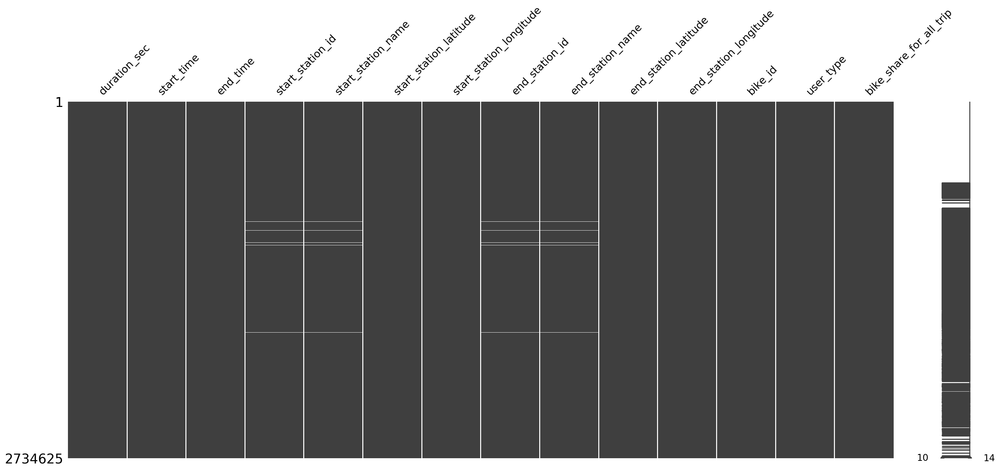

In [12]:
ms.matrix(df)

It seems that we also have a problem with missing data.

In [13]:
df.isna().sum()

duration_sec                   0
start_time                     0
end_time                       0
start_station_id           12501
start_station_name         12501
start_station_latitude         0
start_station_longitude        0
end_station_id             12501
end_station_name           12501
end_station_latitude           0
end_station_longitude          0
bike_id                        0
user_type                      0
bike_share_for_all_trip        0
dtype: int64

We also have some null values in the fields related to the stations.

In [14]:
df.duplicated().sum()

0

We don't have any duplicates. Let's dig a little deeper.

In [15]:
df.query('start_station_latitude == 0 | start_station_longitude == 0')

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
2536194,175,2019-04-24 16:56:54.5160,2019-04-24 16:59:50.4290,420.0,SF Test Station,0.0,0.0,81.0,Berry St at 4th St,37.77588,-122.39317,1161,Subscriber,No


We seem to have a test station with 0 latitude and longitude. We drop this so that it doesn't present as an outlier later on.

In [16]:
index_of_row = df.query(
    'start_station_latitude == 0 | start_station_longitude == 0').index
index_of_row

Int64Index([2536194], dtype='int64')

In [17]:
df.drop(index_of_row, inplace=True)

In [18]:
df.query('start_station_latitude == 0 | start_station_longitude == 0')

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip


In [19]:
df[df.start_station_id.isnull()].head(10)

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
623364,5572,2018-06-30 20:58:31.8550,2018-06-30 22:31:24.5930,NaN,NaN,37.40,-121.94,NaN,NaN,37.40,-121.94,4202,Customer,No
623376,573,2018-06-30 22:12:27.5110,2018-06-30 22:22:01.1740,NaN,NaN,37.40,-121.94,NaN,NaN,37.40,-121.93,4095,Subscriber,Yes
623393,850,2018-06-30 22:01:25.5850,2018-06-30 22:15:36.1510,NaN,NaN,37.41,-121.94,NaN,NaN,37.41,-121.95,4122,Customer,No
623429,562,2018-06-30 21:52:05.1180,2018-06-30 22:01:27.4400,NaN,NaN,37.41,-121.94,NaN,NaN,37.42,-121.94,4184,Subscriber,No
623456,819,2018-06-30 21:37:34.5060,2018-06-30 21:51:13.7290,NaN,NaN,37.41,-121.94,NaN,NaN,37.41,-121.96,4137,Customer,No
623472,1176,2018-06-30 21:23:30.4880,2018-06-30 21:43:07.3310,NaN,NaN,37.41,-121.94,NaN,NaN,37.41,-121.94,4152,Customer,No
623479,160,2018-06-30 21:37:50.9260,2018-06-30 21:40:30.9300,NaN,NaN,37.41,-121.94,NaN,NaN,37.42,-121.94,4105,Subscriber,No
623548,7242,2018-06-30 19:19:19.5600,2018-06-30 21:20:02.1110,NaN,NaN,37.40,-121.94,NaN,NaN,37.40,-121.94,4082,Customer,No
623549,725,2018-06-30 21:06:44.3580,2018-06-30 21:18:50.2180,NaN,NaN,37.41,-121.96,NaN,NaN,37.41,-121.96,4156,Customer,No
623550,694,2018-06-30 21:05:49.6180,2018-06-30 21:17:24.2670,NaN,NaN,37.40,-121.93,NaN,NaN,37.41,-121.94,4136,Customer,No


In [20]:
df[df.start_station_id.isnull()].tail(10)

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
2695824,1041,2019-04-04 18:33:16.8310,2019-04-04 18:50:37.8710,NaN,NaN,37.36,-121.89,NaN,NaN,37.36,-121.89,4093,Customer,No
2717043,1342,2019-04-02 19:08:43.6910,2019-04-02 19:31:06.6260,NaN,NaN,37.40,-121.93,NaN,NaN,37.40,-121.92,4211,Customer,No
2717575,1132,2019-04-02 18:30:33.0320,2019-04-02 18:49:25.4340,NaN,NaN,37.41,-121.93,NaN,NaN,37.41,-121.94,4085,Customer,No
2717972,1241,2019-04-02 18:05:53.0930,2019-04-02 18:26:34.3630,NaN,NaN,37.41,-121.95,NaN,NaN,37.41,-121.95,4107,Customer,No
2719919,1403,2019-04-02 16:33:41.3320,2019-04-02 16:57:04.4700,NaN,NaN,37.40,-121.93,NaN,NaN,37.36,-121.89,4093,Customer,No
2721722,681,2019-04-02 12:27:15.5310,2019-04-02 12:38:36.9320,NaN,NaN,37.39,-121.93,NaN,NaN,37.40,-121.93,4211,Subscriber,No
2725534,4803,2019-04-01 19:03:07.4730,2019-04-01 20:23:10.7310,NaN,NaN,37.40,-121.93,NaN,NaN,37.40,-121.94,4270,Customer,No
2728415,13460,2019-04-01 13:42:15.0730,2019-04-01 17:26:35.8950,NaN,NaN,37.41,-121.95,NaN,NaN,37.40,-121.94,4098,Customer,No
2730120,229,2019-04-01 13:17:14.5670,2019-04-01 13:21:03.9410,NaN,NaN,37.41,-121.94,NaN,NaN,37.41,-121.94,4098,Customer,No
2733653,647,2019-04-01 07:50:49.5360,2019-04-01 08:01:37.2420,NaN,NaN,37.40,-121.93,NaN,NaN,37.39,-121.93,4211,Subscriber,No


All the rows with missing data have similar coordinates. Also these coordinates are less precise than the other entries with no missing data.

Let's look at the most frequently occuring coordinates.

In [21]:
df[df.start_station_id.isnull()].start_station_latitude.value_counts()

37.41    5153
37.40    4669
37.42    1259
37.39     868
37.38     415
37.34      37
37.43      23
37.37      17
37.35      17
37.33      17
37.36       9
45.51       4
40.66       3
37.44       3
37.32       2
44.95       2
45.50       2
37.45       1
Name: start_station_latitude, dtype: int64

In [22]:
df[df.start_station_id.isnull()].start_station_longitude.value_counts()

-121.94    4266
-121.93    3006
-121.96    2079
-121.95    1659
-121.92    1287
-121.97      52
-121.91      41
-121.98      33
-121.90      25
-121.89      22
-121.88       8
-73.57        6
-121.87       4
-121.84       3
-74.01        3
-121.86       3
-93.22        2
-121.83       1
-121.99       1
Name: start_station_longitude, dtype: int64

The most frequent coordinates are at 37.41 latitude and -121.94 longitude.

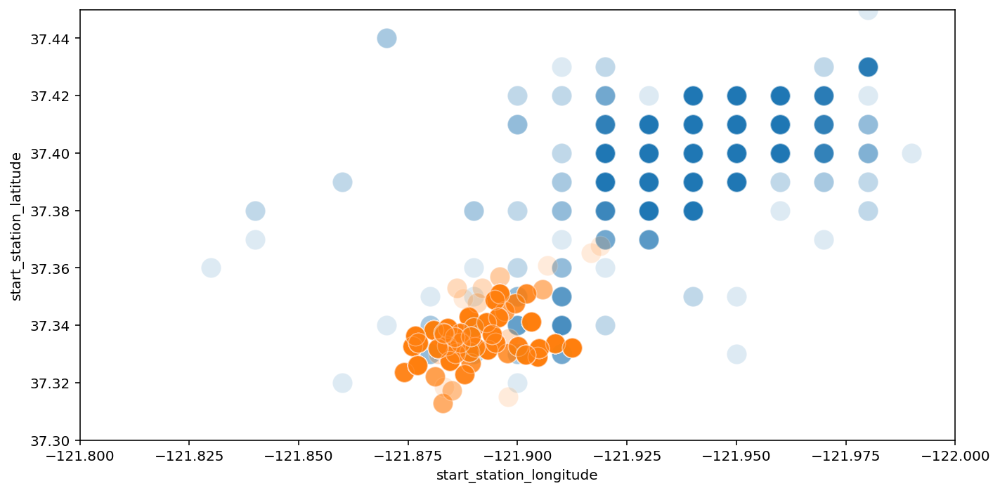

In [23]:
axes, figure = plt.subplots(figsize=(10, 5))
sns.scatterplot(data=df[df.start_station_id.isnull(
)], x="start_station_longitude", y="start_station_latitude", alpha=0.15, s=200)
sns.scatterplot(data=df.dropna(subset=["start_station_id"]).sample(
    50000), x="start_station_longitude", y="start_station_latitude", alpha=0.15, s=200)
plt.xlim(-121.8, -122)
plt.ylim(37.3, 37.45)
plt.tight_layout()

We can see that these 'nan' stations are mostly out of the range of the other stations.

In [24]:
# if all ids have a start and ending point
start_station_id_list = list(
    df.start_station_id.drop_duplicates().dropna().astype("int"))
start_station_id_list.sort()

end_station_id_list = list(
    df.end_station_id.drop_duplicates().dropna().astype("int"))
end_station_id_list.sort()

start_station_id_list == end_station_id_list

False

In [25]:
df_station_names = df[["end_station_id", "end_station_name",
                       "end_station_latitude", "end_station_longitude"]].copy()

df_station_names.rename(columns={"end_station_id": "id",
                                 "end_station_name": "station_name",
                                 "end_station_latitude": "station_latitude",
                                 "end_station_longitude": "station_longitude"}, inplace=True)

df_station_names.drop_duplicates(inplace=True)
df_station_names.dropna(inplace=True)
df_station_names.sort_values("id", inplace=True)
df_station_names.reset_index(inplace=True, drop=True)
df_station_names.drop(
    df_station_names.query('station_latitude == 0 | station_longitude == 0').index, inplace=True)
print(df_station_names)

        id                                  station_name  station_latitude  \
0      3.0  Powell St BART Station (Market St at 4th St)         37.786375   
1      4.0                   Cyril Magnin St at Ellis St         37.785881   
2      5.0  Powell St BART Station (Market St at 5th St)         37.783899   
3      6.0                 The Embarcadero at Sansome St         37.804770   
4      7.0                           Frank H Ogawa Plaza         37.804562   
..     ...                                           ...               ...   
398  412.0                        Glen Park BART Station         37.732813   
399  415.0                     Delmas Ave at Virginia St         37.319757   
400  416.0         Auzerais Ave at Los Gatos Creek Trail         37.321182   
401  417.0                           Park Ave at Race St         37.326011   
402  418.0                     17th St at Santa Clara St         37.343985   

     station_longitude  
0          -122.404904  
1          -1

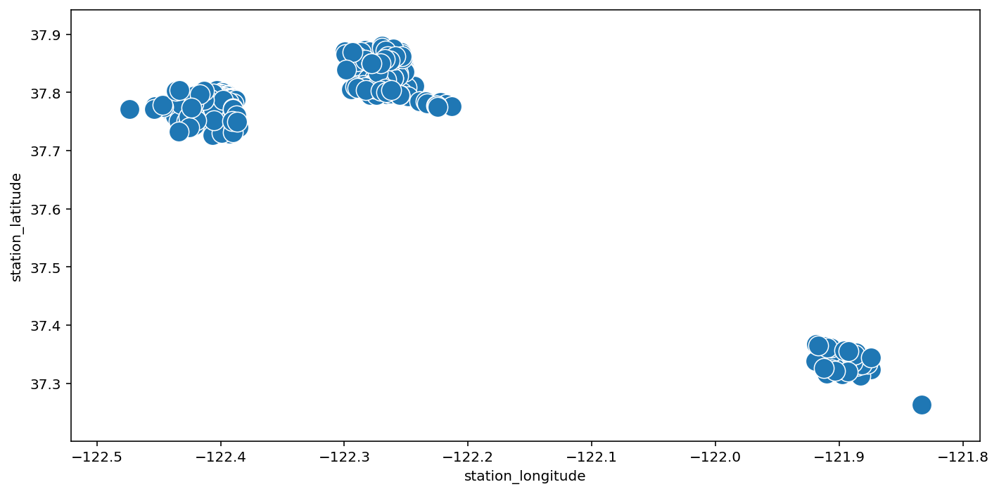

In [26]:
axes, figure = plt.subplots(figsize=(10, 5))
# sns.scatterplot(data = df[df.start_station_id.isnull()], x = "start_station_longitude", y = "start_station_latitude", alpha = 0.15, s = 200)
sns.scatterplot(data=df_station_names, x="station_longitude",
                y="station_latitude", s=200)
# plt.xlim(-122.5, -121.8)
# plt.ylim(37.2, 37.9)
plt.tight_layout()

At first we can see, that there are three clear clusters in this dataset. The website of FordGoBike differs following zones: "San Francisco, East Bay, San José"

In [27]:
df_station_names.id.value_counts()[df_station_names.id.value_counts() > 1]

233.0    3
244.0    3
221.0    3
192.0    3
130.0    3
205.0    3
101.0    3
212.0    3
208.0    3
280.0    3
173.0    2
224.0    2
80.0     2
358.0    2
272.0    2
234.0    2
37.0     2
364.0    2
302.0    2
321.0    2
345.0    2
281.0    2
344.0    2
245.0    2
250.0    2
Name: id, dtype: int64

Here we can see an interesting thing: One ID can refer to multiple different stations.

In [28]:
df_station_names[df_station_names.duplicated("id", keep=False)]

,id,station_name,station_latitude,station_longitude
32,37.0,2nd St at Folsom St,37.785377,-122.396906
33,37.0,2nd St at Folsom St,37.785000,-122.395936
71,80.0,Townsend St at 5th St,37.775235,-122.397437
72,80.0,Townsend St at 5th St,37.775306,-122.397380
90,101.0,San Bruno Ave at 16th St,37.766008,-122.405677
91,101.0,15th St at Potrero Ave,37.767079,-122.407359
92,101.0,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706
117,130.0,22nd St Caltrain Station,37.757369,-122.392057
118,130.0,22nd St Caltrain Station,37.757718,-122.391813
119,130.0,22nd St Caltrain Station,37.757288,-122.392051


If we filter the data by these stations, which didn't changed the position and just got a new name, we can exclude 4 cases. The rest of the cases are still relevant to investigate.

In [29]:
df_consistency = df[["end_station_id", "end_station_name", "end_station_latitude", "end_station_longitude"]].copy(
).merge(df_station_names, left_on="end_station_id", right_on="id", how="outer")

df_consistency_issues = df_consistency.drop_duplicates().dropna()

df_stat_dist = df_consistency_issues[(df_consistency_issues.end_station_latitude != df_consistency_issues.station_latitude) &
                                     (df_consistency_issues.end_station_longitude != df_consistency_issues.station_longitude)].copy()

In [30]:
def calculate_coord_dist(col):
    coords_1 = (col[0], col[1])
    coords_2 = (col[2], col[3])

    return geopy.distance.distance(coords_1, coords_2).m

In [31]:
df_stat_dist["dist_in_m"] = df_stat_dist[["end_station_latitude", "end_station_longitude",
                                          "station_latitude", "station_longitude"]].apply(calculate_coord_dist, axis=1)

df_stat_dist_data = df_stat_dist.drop_duplicates(
    "dist_in_m").sort_values("dist_in_m", ascending=False)
df_stat_dist_data

,end_station_id,end_station_name,end_station_latitude,end_station_longitude,id,station_name,station_latitude,station_longitude,dist_in_m
2698688,302.0,Tamien Station,37.312854,-121.882941,302.0,Tamien Station,37.347721,-121.890856,3932.748999
2533654,208.0,S. 4th St at San Carlos St,37.332836,-121.883912,208.0,William St at 4th St (Temporary Location),37.329964,-121.881922,364.265420
2533652,208.0,S. 4th St at San Carlos St,37.332836,-121.883912,208.0,S. 4th St at San Carlos St,37.330040,-121.881821,361.415566
2503300,192.0,MLK Jr Way at 36th St (Temporary Location),37.825794,-122.269399,192.0,37th St at West St,37.826696,-122.271797,233.626399
2501534,192.0,37th St at West St,37.826696,-122.271795,192.0,MLK Jr Way at 36th St (Temporary Location),37.825794,-122.269399,233.531418
2562862,101.0,San Bruno Ave at 16th St,37.766008,-122.405677,101.0,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,191.626235
2562861,101.0,San Bruno Ave at 16th St,37.766008,-122.405677,101.0,15th St at Potrero Ave,37.767079,-122.407359,189.950941
895709,205.0,Shafter Ave at Cavour St,37.837947,-122.257243,205.0,Miles Ave at Cavour St,37.838800,-122.258732,161.715577
1842718,212.0,Webster St at MacArthur Blvd (Temporary Location),37.825008,-122.261649,212.0,Mosswood Park,37.824893,-122.260437,107.512093
1834479,212.0,Mosswood Park,37.824931,-122.260479,212.0,Webster St at MacArthur Blvd (Temporary Location),37.825008,-122.261649,103.387088


We can see that the range of distance between new stations lies between 0 to 364 meters (and nearly 4 km in the worst case). This needs to be a part of data cleaning. Now we will look at the overall number structure of this dataset.

In [32]:
df.describe().round(3)

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id
count,2734624.000,2722123.000,2734624.000,2734624.000,2722123.000,2734624.000,2734624.000,2734624.000
mean,831.622,125.861,37.768,-122.351,124.354,37.768,-122.350,2929.798
std,2232.948,105.223,0.103,0.151,105.232,0.142,0.348,1762.695
min,61.000,3.000,37.263,-122.474,3.000,0.000,-122.474,11.000
25%,346.000,37.000,37.770,-122.412,33.000,37.771,-122.411,1501.000
50%,550.000,92.000,37.781,-122.397,90.000,37.781,-122.397,2835.000
75%,861.000,196.000,37.797,-122.289,196.000,37.797,-122.290,4225.000
max,86366.000,418.000,45.510,-73.570,420.000,45.510,0.000,7108.000


Nothing too obvious here. But there seems to be an outlier at the maximum duration_sec.

In [33]:
df.query("duration_sec == 86366")

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
187716,86366,2018-02-03 17:32:04.0420,2018-02-04 17:31:30.7880,197.0,El Embarcadero at Grand Ave,37.808848,-122.24968,197.0,El Embarcadero at Grand Ave,37.808848,-122.24968,1486,Customer,No


In [34]:
df.query("duration_sec > 80000")

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
1,85422,2018-01-31 16:13:34.3510,2018-02-01 15:57:17.3100,15.0,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,15.0,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,2815,Customer,No
2228,85546,2018-01-30 14:45:44.4800,2018-01-31 14:31:31.0530,6.0,The Embarcadero at Sansome St,37.804770,-122.403234,24.0,Spear St at Folsom St,37.789677,-122.390428,364,Customer,No
19446,84609,2018-01-25 17:35:02.5140,2018-01-26 17:05:12.3710,49.0,S Park St at 3rd St,37.780760,-122.394989,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,3642,Subscriber,No
58407,81712,2018-01-14 13:13:21.0610,2018-01-15 11:55:13.3250,191.0,Market St at 40th St,37.830545,-122.273937,191.0,Market St at 40th St,37.830545,-122.273937,125,Customer,No
60139,85079,2018-01-13 13:44:59.5890,2018-01-14 13:22:59.2720,43.0,San Francisco Public Library (Grove St at Hyde...,37.778768,-122.415929,31.0,Raymond Kimbell Playground,37.783813,-122.434559,2841,Customer,No
60173,80533,2018-01-13 14:46:01.9620,2018-01-14 13:08:15.7780,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,56.0,Koshland Park,37.773414,-122.427317,690,Customer,No
69713,84193,2018-01-10 10:01:32.3520,2018-01-11 09:24:46.2680,15.0,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,72.0,Page St at Scott St,37.772406,-122.435650,3653,Subscriber,No
92407,80302,2018-01-01 11:36:19.2680,2018-01-02 09:54:42.1480,241.0,Ashby BART Station,37.852477,-122.270213,241.0,Ashby BART Station,37.852477,-122.270213,3430,Customer,No
108285,80752,2018-02-24 14:16:07.9350,2018-02-25 12:42:00.4730,62.0,Victoria Manalo Draves Park,37.777791,-122.406432,342.0,Colin P Kelly Jr St at Townsend St (Temporary ...,37.781383,-122.389841,1792,Customer,No
109965,82901,2018-02-23 14:36:35.3580,2018-02-24 13:38:16.3940,61.0,Howard St at 8th St,37.776513,-122.411306,116.0,Mississippi St at 17th St,37.764802,-122.394771,1976,Customer,No


We don't usually see trips this long. May be someone forgot to unregister their bike. Or may be some users really rent these bikes for this duration.

## Assessing Summary

1. There are missing values in the station_id, station_name columns
2. The columns 'start_time' and 'end_time' are not datetime type
3. The columns 'start_station_id', 'end_station_id' and 'bike_id' are not object type
4. The columns 'user_type' and 'bike_share_for_all_trip' are not categorical type
5. Some stations share the same ID while they changed the position over time (consistency problem)

## Data Cleaning

1. There are missing values in the station_id, station_name columns

In [35]:
# there are multiple ways how to handle this - but since the coordinates are not precise we will just drop them
df.dropna(subset=["start_station_id"], inplace=True)

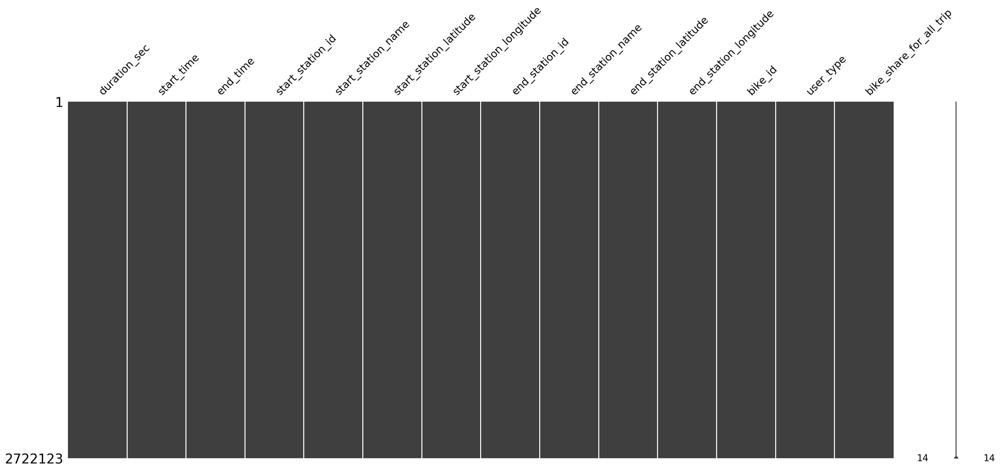

In [36]:
ms.matrix(df)

2. The columns 'start_time' and 'end_time' are not datetime type
3. The columns 'start_station_id', 'end_station_id' and 'bike_id' are not object type
4. The columns 'user_type' and 'bike_share_for_all_trip' are not categorical type

In [37]:
for col in ["start_time", "end_time"]:
    df[col] = pd.to_datetime(df[col])

for col in ["start_station_id", "end_station_id"]:
    df[col] = df[col].astype('int')

for col in ["start_station_id", "end_station_id", "bike_id"]:
    df[col] = df[col].astype('str')

for col in ["user_type", "bike_share_for_all_trip"]:
    df[col] = df[col].astype('category')

In [38]:
df.info(null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2722123 entries, 0 to 2734624
Data columns (total 14 columns):
duration_sec               2722123 non-null int64
start_time                 2722123 non-null datetime64[ns]
end_time                   2722123 non-null datetime64[ns]
start_station_id           2722123 non-null object
start_station_name         2722123 non-null object
start_station_latitude     2722123 non-null float64
start_station_longitude    2722123 non-null float64
end_station_id             2722123 non-null object
end_station_name           2722123 non-null object
end_station_latitude       2722123 non-null float64
end_station_longitude      2722123 non-null float64
bike_id                    2722123 non-null object
user_type                  2722123 non-null category
bike_share_for_all_trip    2722123 non-null category
dtypes: category(2), datetime64[ns](2), float64(4), int64(1), object(5)
memory usage: 275.2+ MB


5. Some stations share the same ID while they changed the position over time (consistency problem)

We have two options here. In the first approach, we can just ignore most of these cases, because the different stations are relatively close to each other. That raises the question: How close is close? Another approach is to give the ID's a new "subindex". So every time the coordinates of a station ID differs from the occurrence of this station before, we will increase the subindex by 1, if the calculated difference is > x.

We'll try the second approach

In [39]:
df.sort_values("start_time", inplace=True)
df.reset_index(inplace=True, drop=True)
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip
0,13709,2018-01-01 00:01:53.847,2018-01-01 03:50:23.433,86,Market St at Dolores St,37.769305,-122.426826,119,18th St at Noe St,37.761047,-122.432642,2924,Customer,No
1,145,2018-01-01 00:07:41.040,2018-01-01 00:10:06.241,316,San Salvador St at 1st St,37.330165,-121.885831,311,Paseo De San Antonio at 2nd St,37.333798,-121.886943,2473,Subscriber,No
2,714,2018-01-01 00:07:52.943,2018-01-01 00:19:47.075,74,Laguna St at Hayes St,37.776435,-122.426244,70,Central Ave at Fell St,37.773311,-122.444293,2423,Subscriber,No
3,1151,2018-01-01 00:09:31.745,2018-01-01 00:28:43.159,97,14th St at Mission St,37.768265,-122.420110,125,20th St at Bryant St,37.759200,-122.409851,3455,Subscriber,No
4,1359,2018-01-01 00:14:37.187,2018-01-01 00:37:16.445,11,Davis St at Jackson St,37.797280,-122.398436,323,Broadway at Kearny,37.798014,-122.405950,2173,Customer,No


Let's create a function for this

In [40]:
def get_new_id(col):

    # when the row is not in id_data - append it
    if col[0] not in id_data:
        id_data[col[0]] = [col[1], col[2], col[3], f"{col[0]}_0"]
        return id_data[col[0]][3]

    # if the row exists in id_data, then check if the coordinates change, if yes - calculate the distance and increase the id and replace the \
    # saved coordinates in id_data with the new ones, if not, then just return the saved id
    elif col[0] in id_data:
        if id_data[col[0]][1] != col[2] or id_data[col[0]][2] != col[3]:
            coords_1 = (id_data[col[0]][1], id_data[col[0]][2])
            coords_2 = (col[2], col[3])

            if geopy.distance.distance(coords_1, coords_2).m > 100:
                new_ind = str(col[0]) + "_" + \
                    str(int(id_data[col[0]][3][-1])+1)
                id_data[col[0]][3] = new_ind
                id_data[col[0]][1] = col[2]
                id_data[col[0]][2] = col[3]

                return new_ind
            else:
                return id_data[col[0]][3]

        else:
            return id_data[col[0]][3]

    else:
        return "Error"

In [41]:
id_data = {}
df["start_station_id_new"] = df[["start_station_id", "start_station_name",
                                 "start_station_latitude", "start_station_longitude"]].apply(get_new_id, axis=1)

In [42]:
id_data = {}
df["end_station_id_new"] = df[["end_station_id", "end_station_name",
                               "end_station_latitude", "end_station_longitude"]].apply(get_new_id, axis=1)

In [43]:
df_station_names.head()

,id,station_name,station_latitude,station_longitude
0,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904
1,4.0,Cyril Magnin St at Ellis St,37.785881,-122.408915
2,5.0,Powell St BART Station (Market St at 5th St),37.783899,-122.408445
3,6.0,The Embarcadero at Sansome St,37.804770,-122.403234
4,7.0,Frank H Ogawa Plaza,37.804562,-122.271738


In [44]:
df_station_names = df[["start_time", "start_station_id", "start_station_name",
                       "start_station_latitude", "start_station_longitude"]].copy()
df_station_names.sort_values("start_time", inplace=True)
df_station_names.drop("start_time", axis=1, inplace=True)
df_station_names.rename(columns={"start_station_id": "id",
                                 "start_station_name": "station_name",
                                 "start_station_latitude": "station_latitude",
                                 "start_station_longitude": "station_longitude"}, inplace=True)

df_station_names.drop_duplicates(inplace=True)
df_station_names.dropna(inplace=True)
id_data = {}
df_station_names["new_id"] = df_station_names[["id", "station_name",
                                               "station_latitude", "station_longitude"]].apply(get_new_id, axis=1)
df_station_names.sort_values("id", inplace=True)
df_station_names.reset_index(inplace=True, drop=True)

In [45]:
df_station_names.head()

,id,station_name,station_latitude,station_longitude,new_id
0,10,Washington St at Kearny St,37.795393,-122.404770,10_0
1,100,Bryant St at 15th St,37.767100,-122.410662,100_0
2,101,15th St at Potrero Ave,37.767079,-122.407359,101_1
3,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0
4,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1


Let's see if it worked.

In [46]:
df.query("start_station_id == '101'").drop_duplicates("start_station_id_new")[
    ["start_station_id", "start_station_name", "start_station_latitude", "start_station_longitude", "start_station_id_new"]]

,start_station_id,start_station_name,start_station_latitude,start_station_longitude,start_station_id_new
838,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0
1013323,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1


In [47]:
df.query("end_station_id == '101'").drop_duplicates("end_station_id_new")[
    ["end_station_id", "end_station_name", "end_station_latitude", "end_station_longitude", "end_station_id_new"]]

,end_station_id,end_station_name,end_station_latitude,end_station_longitude,end_station_id_new
350,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0
1013578,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1


Seems like it works. We'll save this new data frame into its own file for later use.

In [48]:
# export the station names to csv
df_station_names.to_csv("./data/processed/df_station_names.csv", index=False)
df_station_names.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 403 entries, 0 to 402
Data columns (total 5 columns):
id                   403 non-null object
station_name         403 non-null object
station_latitude     403 non-null float64
station_longitude    403 non-null float64
new_id               403 non-null object
dtypes: float64(2), object(3)
memory usage: 15.9+ KB


In [49]:
# export the cleaned csv
df.to_csv("./data/processed/dataset_clean.csv", index=False)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2722123 entries, 0 to 2722122
Data columns (total 16 columns):
duration_sec               int64
start_time                 datetime64[ns]
end_time                   datetime64[ns]
start_station_id           object
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             object
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    object
user_type                  category
bike_share_for_all_trip    category
start_station_id_new       object
end_station_id_new         object
dtypes: category(2), datetime64[ns](2), float64(4), int64(1), object(7)
memory usage: 295.9+ MB


### What is the structure of your dataset?

The FordGoBike data is straightforward and intuitive to understand. This data has been collected efficiently, providing a valuable collection of data to work with and draw conclusions from.

The column header descriptions are as follows (each trip is anonymized):

- Trip Duration (seconds)
- Start Time and Date
- End Time and Date
- Start Station ID
- Start Station Name
- Start Station Latitude
- Start Station Longitude
- End Station ID
- End Station Name
- End Station Latitude
- End Station Longitude
- Bike ID
- User Type (Subscriber or Customer – “Subscriber” = Member or “Customer” = Casual)
- Bike Share for All Trip


Following columns have been added during cleaning task:

- Start Station ID New (new IDs given for same stations but different locations)
- End Station ID New (new IDs given for same stations but different locations)

Another dataset has been created which is a subset of this dataset. This new dataset contains all the stations details with the following columns:

- ID
- Station Name
- Station Latitude
- Station Longitude
- ID New (new IDs given for same stations but different locations)

### What is/are the main feature(s) of interest in your dataset?

The main features include data related to the start and end of a ride. This can be used to calculate when bikes are in high or low demand. There is also ample data related to the users of the bike service, whether they are a paying member or a casual user. These features can be used to make business decisions such as working class people or students to target in marketing campaigns, or which day of the week bikes should be most available.

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

The start and end times, and related time-based information will be utilized heavily. Trip related data as well as the distances to understand each trip, its duration, usage etc.

## Exploratory Data Visualization

Now that the cleaning part is done, we can start to visualize the data.

In [50]:
df = pd.read_csv("./data/processed/dataset_clean.csv")
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2722123 entries, 0 to 2722122
Data columns (total 16 columns):
duration_sec               int64
start_time                 object
end_time                   object
start_station_id           int64
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             int64
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    int64
user_type                  object
bike_share_for_all_trip    object
start_station_id_new       object
end_station_id_new         object
dtypes: float64(4), int64(4), object(8)
memory usage: 332.3+ MB


In [51]:
for col in ["start_time", "end_time"]:
    df[col] = pd.to_datetime(df[col])

for col in ["start_station_id", "end_station_id"]:
    df[col] = df[col].astype('int')

for col in ["start_station_id", "end_station_id", "bike_id"]:
    df[col] = df[col].astype('str')

for col in ["user_type", "bike_share_for_all_trip"]:
    df[col] = df[col].astype('category')

In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2722123 entries, 0 to 2722122
Data columns (total 16 columns):
duration_sec               int64
start_time                 datetime64[ns]
end_time                   datetime64[ns]
start_station_id           object
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             object
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    object
user_type                  category
bike_share_for_all_trip    category
start_station_id_new       object
end_station_id_new         object
dtypes: category(2), datetime64[ns](2), float64(4), int64(1), object(7)
memory usage: 295.9+ MB


In [53]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip,start_station_id_new,end_station_id_new
0,13709,2018-01-01 00:01:53.847,2018-01-01 03:50:23.433,86,Market St at Dolores St,37.769305,-122.426826,119,18th St at Noe St,37.761047,-122.432642,2924,Customer,No,86_0,119_0
1,145,2018-01-01 00:07:41.040,2018-01-01 00:10:06.241,316,San Salvador St at 1st St,37.330165,-121.885831,311,Paseo De San Antonio at 2nd St,37.333798,-121.886943,2473,Subscriber,No,316_0,311_0
2,714,2018-01-01 00:07:52.943,2018-01-01 00:19:47.075,74,Laguna St at Hayes St,37.776435,-122.426244,70,Central Ave at Fell St,37.773311,-122.444293,2423,Subscriber,No,74_0,70_0
3,1151,2018-01-01 00:09:31.745,2018-01-01 00:28:43.159,97,14th St at Mission St,37.768265,-122.420110,125,20th St at Bryant St,37.759200,-122.409851,3455,Subscriber,No,97_0,125_0
4,1359,2018-01-01 00:14:37.187,2018-01-01 00:37:16.445,11,Davis St at Jackson St,37.797280,-122.398436,323,Broadway at Kearny,37.798014,-122.405950,2173,Customer,No,11_0,323_0


In [54]:
df_station_names = pd.read_csv("./data/processed/df_station_names.csv")

In [55]:
df_station_names.head()

,id,station_name,station_latitude,station_longitude,new_id
0,10,Washington St at Kearny St,37.795393,-122.404770,10_0
1,100,Bryant St at 15th St,37.767100,-122.410662,100_0
2,101,15th St at Potrero Ave,37.767079,-122.407359,101_1
3,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0
4,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1


Before we start visualizing, we can extract some additional information out of the data to improve the insights. We saw, that these datapoints can be separated in three clusters. Since these clusters are really obvious, we can classify them in an efficient manner using the K-Means Clustering algorithm.

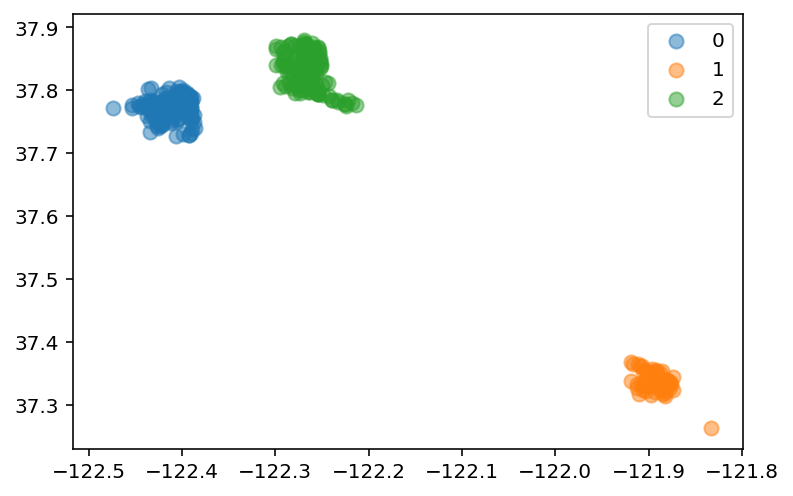

In [56]:
kmeans = KMeans(n_clusters=3).fit(
    df_station_names[["station_longitude", "station_latitude"]])

df_station_names["label"] = kmeans.labels_

for x in set(list(df_station_names.label)):

    df_plot_cluster = df_station_names.query(f"label == {x}")

    plt.scatter(df_plot_cluster['station_longitude'],
                df_plot_cluster["station_latitude"], s=50, alpha=0.5, label=x)

#     plt.xlim(-122.5, -121.8)
#     plt.ylim(37.2, 37.9)

plt.legend()

Now that this is done, we can visualize this data on a map. This can happen with Bokeh or Plotly, but we will use kepler.gl out of the visualization toolbox for map visualizations. This is an incredibly easy tool to create map based visualizations.

**Source:** <a href = https://kepler.gl/>kepler.gl</a>

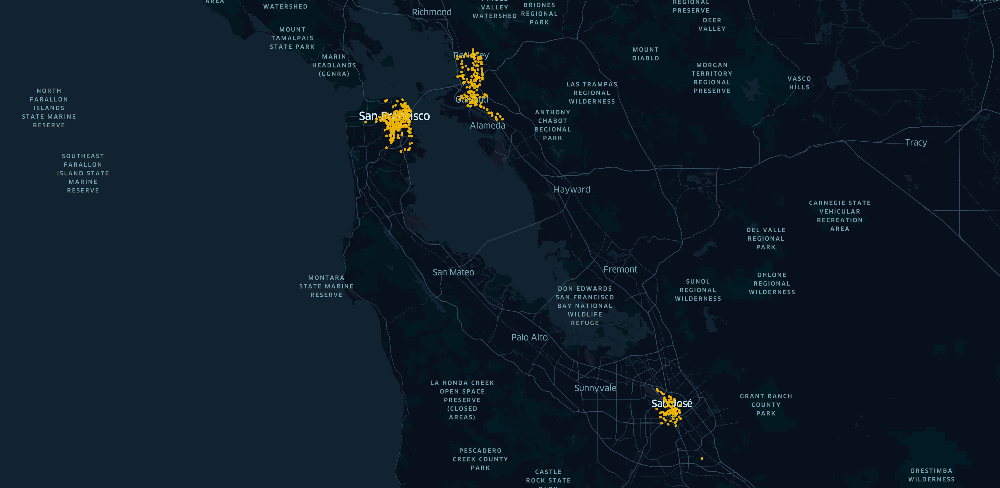
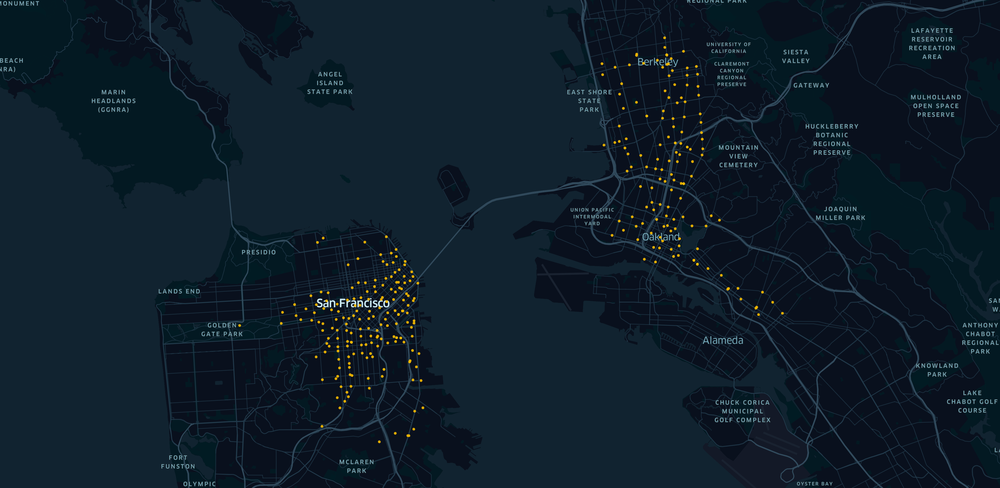
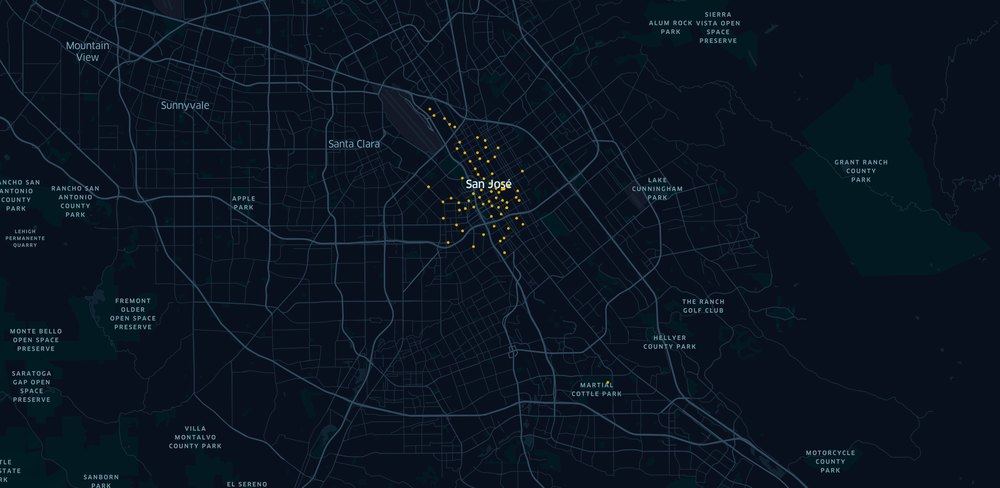

Now we will map the labels with the original names.

In [57]:
mapping = {0: "San Francisco", 1: "San José", 2: "East Bay"}

In [58]:
df_station_names["label_name"] = df_station_names["label"].map(mapping)
df_station_names.head()

,id,station_name,station_latitude,station_longitude,new_id,label,label_name
0,10,Washington St at Kearny St,37.795393,-122.404770,10_0,0,San Francisco
1,100,Bryant St at 15th St,37.767100,-122.410662,100_0,0,San Francisco
2,101,15th St at Potrero Ave,37.767079,-122.407359,101_1,0,San Francisco
3,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0,0,San Francisco
4,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1,0,San Francisco


In [59]:
df_station_names.label_name.value_counts()

San Francisco    183
East Bay         147
San José          73
Name: label_name, dtype: int64

In [60]:
# duplicates for new coordinates which are not > 100 m away from the origin
df_station_names[df_station_names.duplicated("new_id", keep=False)]

,id,station_name,station_latitude,station_longitude,new_id,label,label_name
2,101,15th St at Potrero Ave,37.767079,-122.407359,101_1,0,San Francisco
4,101,Potrero Ave at 15th St (Temporary Location),37.766629,-122.407706,101_1,0,San Francisco
31,130,22nd St Caltrain Station,37.757718,-122.391813,130_0,0,San Francisco
32,130,22nd St Caltrain Station,37.757369,-122.392057,130_0,0,San Francisco
33,130,22nd St Caltrain Station,37.757288,-122.392051,130_0,0,San Francisco
76,173,Shattuck Ave at 55th Ave,37.840364,-122.264488,173_0,2,East Bay
77,173,Shattuck Ave at 55th St,37.840364,-122.264488,173_0,2,East Bay
111,205,Miles Ave at Cavour St (Temporary Location),37.838800,-122.258732,205_1,2,East Bay
113,205,Miles Ave at Cavour St,37.838800,-122.258732,205_1,2,East Bay
117,208,William St at 4th St (Temporary Location),37.329964,-121.881922,208_1,1,San José


In [61]:
df_station_names.drop_duplicates(subset=["new_id"], inplace=True)

In [62]:
df_station_names.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 376 entries, 0 to 402
Data columns (total 7 columns):
id                   376 non-null int64
station_name         376 non-null object
station_latitude     376 non-null float64
station_longitude    376 non-null float64
new_id               376 non-null object
label                376 non-null int32
label_name           376 non-null object
dtypes: float64(2), int32(1), int64(1), object(3)
memory usage: 22.0+ KB


In [63]:
df[df.duplicated(subset=["start_time", "end_time"], keep=False)]

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,bike_share_for_all_trip,start_station_id_new,end_station_id_new


In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2722123 entries, 0 to 2722122
Data columns (total 16 columns):
duration_sec               int64
start_time                 datetime64[ns]
end_time                   datetime64[ns]
start_station_id           object
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             object
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    object
user_type                  category
bike_share_for_all_trip    category
start_station_id_new       object
end_station_id_new         object
dtypes: category(2), datetime64[ns](2), float64(4), int64(1), object(7)
memory usage: 295.9+ MB


Now we can merge the labels to the id's of the main dataframe.

In [65]:
df = df.merge(df_station_names[["new_id", "label"]],
              left_on="start_station_id_new", right_on="new_id", how="outer")

In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2722123 entries, 0 to 2722122
Data columns (total 18 columns):
duration_sec               int64
start_time                 datetime64[ns]
end_time                   datetime64[ns]
start_station_id           object
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             object
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    object
user_type                  category
bike_share_for_all_trip    category
start_station_id_new       object
end_station_id_new         object
new_id                     object
label                      int32
dtypes: category(2), datetime64[ns](2), float64(4), int32(1), int64(1), object(8)
memory usage: 347.9+ MB


In [67]:
df[df.label.isnull()].start_station_id_new.value_counts()

Series([], Name: start_station_id_new, dtype: int64)

In [68]:
df.query("start_station_id == '205'").drop_duplicates("start_station_id_new")[
    ["start_station_id", "start_station_name", "start_station_latitude", "start_station_longitude", "start_station_id_new", "label"]]

,start_station_id,start_station_name,start_station_latitude,start_station_longitude,start_station_id_new,label
1383354,205,Shafter Ave at Cavour St,37.837947,-122.257243,205_0,2
2632252,205,Miles Ave at Cavour St (Temporary Location),37.838800,-122.258732,205_1,2


In [69]:
df["label_name"] = df["label"].map(mapping)

In [70]:
df.label_name.value_counts()

San Francisco    2005361
East Bay          592186
San José          124576
Name: label_name, dtype: int64

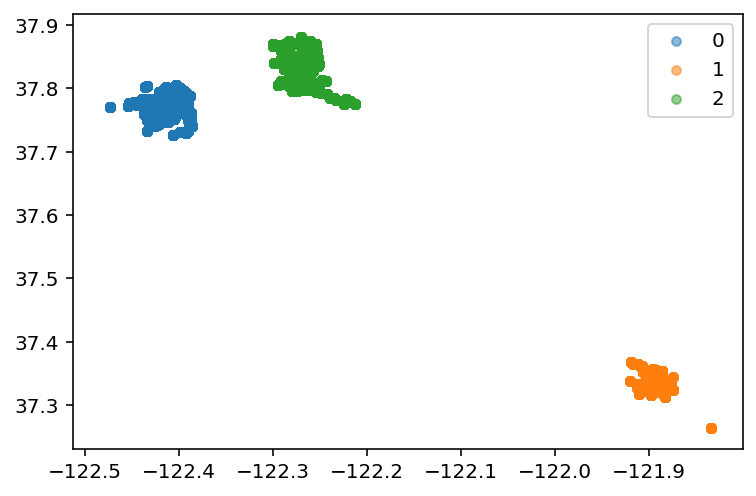

In [71]:
for x in set(list(df.label)):

    df_plot_cluster = df.query(f"label == {x}")

    plt.scatter(df_plot_cluster['start_station_longitude'],
                df_plot_cluster["start_station_latitude"], s=20, alpha=0.5, label=x)

plt.legend()

Now we can extract other information out of the start_time - timestamp.

In [72]:
df['month_year'] = pd.to_datetime(df["start_time"]).dt.to_period('M')

In [73]:
df['day_month_year'] = pd.to_datetime(df["start_time"]).dt.to_period('D')

In [74]:
df["dayofweek"] = df["start_time"].apply(lambda x: x.dayofweek)

In [75]:
df["start_hr"] = df["start_time"].apply(lambda x: x.hour)
df["end_hr"] = df["end_time"].apply(lambda x: x.hour)

In [76]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,start_station_id_new,end_station_id_new,new_id,label,label_name,month_year,day_month_year,dayofweek,start_hr,end_hr
0,13709,2018-01-01 00:01:53.847,2018-01-01 03:50:23.433,86,Market St at Dolores St,37.769305,-122.426826,119,18th St at Noe St,37.761047,...,86_0,119_0,86_0,0,San Francisco,2018-01,2018-01-01,0,0,3
1,9996,2018-01-01 04:37:08.115,2018-01-01 07:23:44.143,86,Market St at Dolores St,37.769305,-122.426826,223,16th St Mission BART Station 2,37.764765,...,86_0,223_0,86_0,0,San Francisco,2018-01,2018-01-01,0,4,7
2,197,2018-01-01 09:29:57.079,2018-01-01 09:33:14.662,86,Market St at Dolores St,37.769305,-122.426826,85,Church St at Duboce Ave,37.770083,...,86_0,85_0,86_0,0,San Francisco,2018-01,2018-01-01,0,9,9
3,183,2018-01-01 11:25:27.634,2018-01-01 11:28:31.059,86,Market St at Dolores St,37.769305,-122.426826,75,Market St at Franklin St,37.773793,...,86_0,75_0,86_0,0,San Francisco,2018-01,2018-01-01,0,11,11
4,893,2018-01-01 12:07:39.271,2018-01-01 12:22:32.393,86,Market St at Dolores St,37.769305,-122.426826,42,San Francisco City Hall (Polk St at Grove St),37.778650,...,86_0,42_0,86_0,0,San Francisco,2018-01,2018-01-01,0,12,12


In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2722123 entries, 0 to 2722122
Data columns (total 24 columns):
duration_sec               int64
start_time                 datetime64[ns]
end_time                   datetime64[ns]
start_station_id           object
start_station_name         object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             object
end_station_name           object
end_station_latitude       float64
end_station_longitude      float64
bike_id                    object
user_type                  category
bike_share_for_all_trip    category
start_station_id_new       object
end_station_id_new         object
new_id                     object
label                      int32
label_name                 object
month_year                 period[M]
day_month_year             period[D]
dayofweek                  int64
start_hr                   int64
end_hr                     int64
dtypes: category(2), datetime64[ns](2), float6

## Univariate Exploration

There are multiple interesting variables in this dataset. Let's start with the stations first.

Text(0.5, 0, 'Start Station ID')

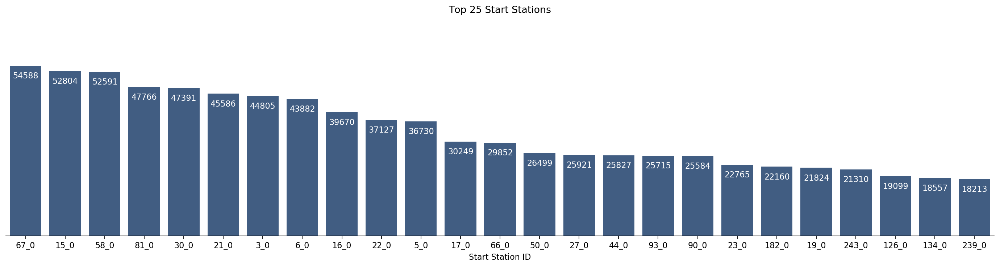

In [78]:
value_ct = df.start_station_id_new.value_counts().iloc[:25]

fig, ax = plt.subplots(figsize=(22, 5), dpi=80)
color = sns.color_palette("viridis")[1]
sns.countplot(x="start_station_id_new", data=df,
              order=value_ct.index, color=color)

plt.ylim(0, 70000)

cur_axes = plt.gca()
# cur_axes.axes.get_xaxis().set_visible(False)
cur_axes.axes.get_yaxis().set_visible(False)

sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.08, p.get_height()-4000), color="white")

plt.title("Top 25 Start Stations")
plt.xlabel("Start Station ID")

Overall we can see, that 67_0, 15_0 and 58_0 are the most "used" stations in this dataset. Let's take a look on each group separately.

In [79]:
for x in value_ct.index:
    print(x + " - " +
          str(df.query(f"start_station_id_new == '{x}'").start_station_name.drop_duplicates().to_numpy()))

67_0 - ['San Francisco Caltrain Station 2  (Townsend St at 4th St)']
15_0 - ['San Francisco Ferry Building (Harry Bridges Plaza)']
58_0 - ['Market St at 10th St']
81_0 - ['Berry St at 4th St']
30_0 - ['San Francisco Caltrain (Townsend St at 4th St)']
21_0 - ['Montgomery St BART Station (Market St at 2nd St)']
3_0 - ['Powell St BART Station (Market St at 4th St)']
6_0 - ['The Embarcadero at Sansome St']
16_0 - ['Steuart St at Market St']
22_0 - ['Howard St at Beale St']
5_0 - ['Powell St BART Station (Market St at 5th St)']
17_0 - ['Embarcadero BART Station (Beale St at Market St)']
66_0 - ['3rd St at Townsend St']
50_0 - ['2nd St at Townsend St']
27_0 - ['Beale St at Harrison St']
44_0 - ['Civic Center/UN Plaza BART Station (Market St at McAllister St)']
93_0 - ['4th St at Mission Bay Blvd S']
90_0 - ['Townsend St at 7th St']
23_0 - ['The Embarcadero at Steuart St']
182_0 - ['19th Street BART Station']
19_0 - ['Post St at Kearny St']
243_0 - ['Bancroft Way at College Ave']
126_0 - ['Es

Text(0.5, 0, 'Start Station ID')

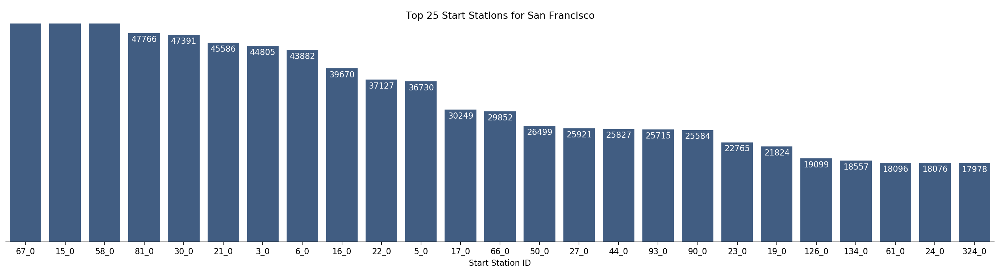

In [80]:
df_new = df.query("label == 0").copy()

value_ct = df_new.start_station_id_new.value_counts().iloc[:25]

fig, ax = plt.subplots(figsize=(22, 5), dpi=80)
color = sns.color_palette("viridis")[1]
sns.countplot(x="start_station_id_new", data=df_new,
              order=value_ct.index, color=color)

plt.ylim(0, 50000)

cur_axes = plt.gca()
# cur_axes.axes.get_xaxis().set_visible(False)
cur_axes.axes.get_yaxis().set_visible(False)

sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.08, p.get_height()-2000), color="white")

plt.title("Top 25 Start Stations for San Francisco")
plt.xlabel("Start Station ID")

For San Francisco we can see that this City is leading the trip counter overall.

Text(0.5, 0, 'Start Station ID')

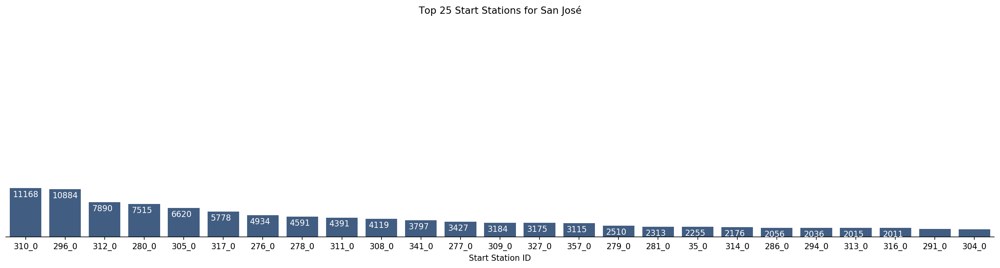

In [81]:
df_new = df.query("label == 1").copy()

value_ct = df_new.start_station_id_new.value_counts().iloc[:25]

fig, ax = plt.subplots(figsize=(22, 5), dpi=80)
color = sns.color_palette("viridis")[1]
sns.countplot(x="start_station_id_new", data=df_new,
              order=value_ct.index, color=color)

plt.ylim(0, 50000)

cur_axes = plt.gca()
# cur_axes.axes.get_xaxis().set_visible(False)
cur_axes.axes.get_yaxis().set_visible(False)

sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.08, p.get_height()-2000), color="white")

plt.title("Top 25 Start Stations for San José")
plt.xlabel("Start Station ID")

Text(0.5, 0, 'Start Station ID')

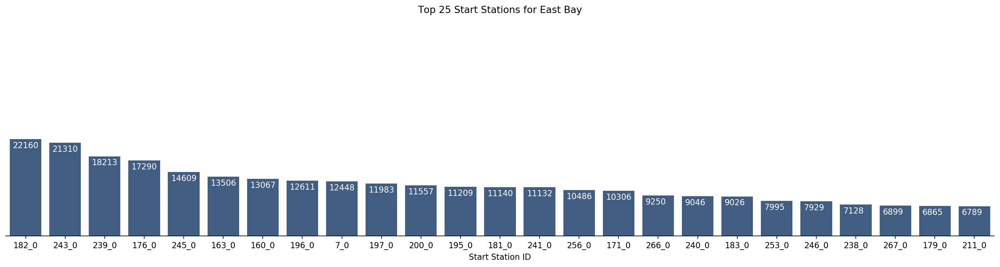

In [82]:
df_new = df.query("label == 2").copy()

value_ct = df_new.start_station_id_new.value_counts().iloc[:25]

fig, ax = plt.subplots(figsize=(22, 5), dpi=80)
color = sns.color_palette("viridis")[1]
sns.countplot(x="start_station_id_new", data=df_new,
              order=value_ct.index, color=color)

plt.ylim(0, 50000)

cur_axes = plt.gca()
# cur_axes.axes.get_xaxis().set_visible(False)
cur_axes.axes.get_yaxis().set_visible(False)

sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.08, p.get_height()-2000), color="white")

plt.title("Top 25 Start Stations for East Bay")
plt.xlabel("Start Station ID")

It seems like the Ford GoBike Program is relatively new in East Bay and San José. These parts have lesser trips than San Francisco. In East Bay the stations 182_0, 243_0 and 176_0 are popular. For San José are the top three 310_0, 296_0 and 312_0. Now that we know, that San Francisco is the city in this project with the most active users, we will now take a look on the duration.

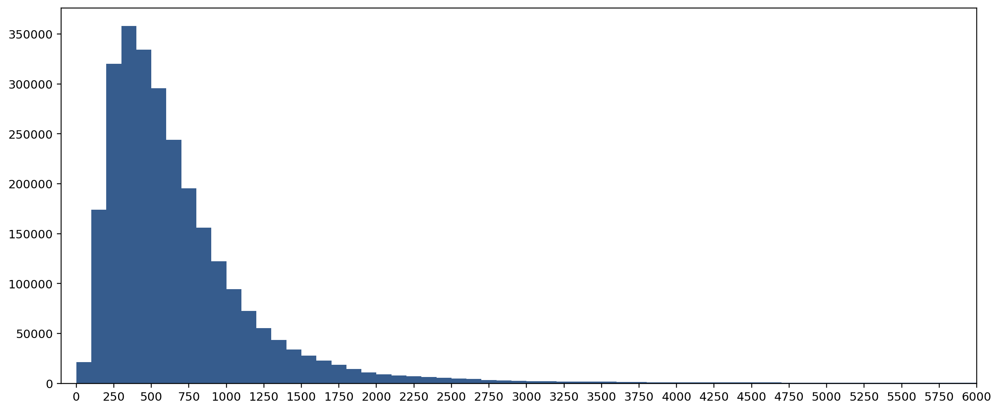

In [83]:
# maybe a customer forgot to log off
bin_size = 100
bins = np.arange(0, df.duration_sec.max()+bin_size, bin_size)

fig, axes = plt.subplots(figsize=(12, 5), dpi=110)

plt.hist(df.duration_sec, bins=bins, color=color)
plt.xticks(ticks=[x for x in range(0, 7000, 250)])
plt.xlim(-100, 6000)
plt.tight_layout()

In [84]:
df.query("duration_sec < 6000").duration_sec.mean()

695.0021178077302

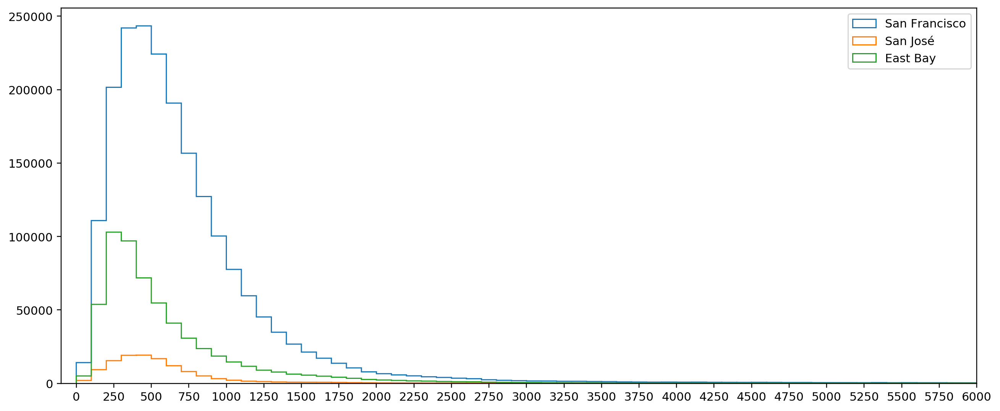

In [85]:
fig, axes = plt.subplots(figsize=(12, 5), dpi=110)
for x in mapping.values():
    df_new = df.query(f"label_name == '{x}'")

    bin_size = 100
    bins = np.arange(0, df_new.duration_sec.max()+bin_size, bin_size)

    plt.hist(df_new.duration_sec, bins=bins, label=x, histtype='step')

plt.xticks(ticks=[x for x in range(0, 7000, 250)])
plt.legend()
plt.xlim(-100, 6000)
plt.tight_layout()

Looking at these, trends are looking similar to each other (right skewed), although it seems like trips in East Bay are usually a little bit shorter in duration.

In [86]:
for x in mapping.values():
    print(x, df.query(
        f"label_name == '{x}' and duration_sec < 6000").duration_sec.mean())

San Francisco 719.8303597521074
San José 616.5976845268873
East Bay 627.6201560134502


The mean values also agree on that.

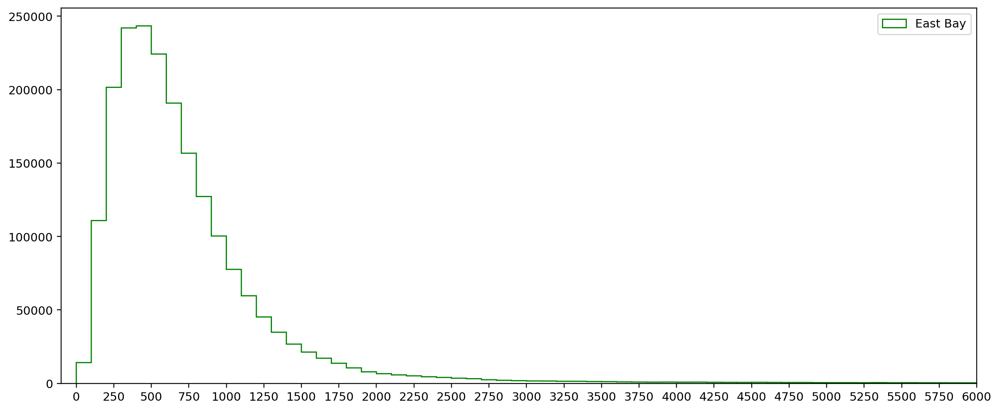

In [87]:
fig, axes = plt.subplots(figsize=(12, 5), dpi=110)
df_new = df.query(f"label_name == 'San Francisco'")

bin_size = 100
bins = np.arange(0, df_new.duration_sec.max()+bin_size, bin_size)

plt.hist(df_new.duration_sec, bins=bins, label=x, histtype='step', color="g")

plt.xticks(ticks=[x for x in range(0, 7000, 250)])
plt.legend()
plt.xlim(-100, 6000)
plt.tight_layout()

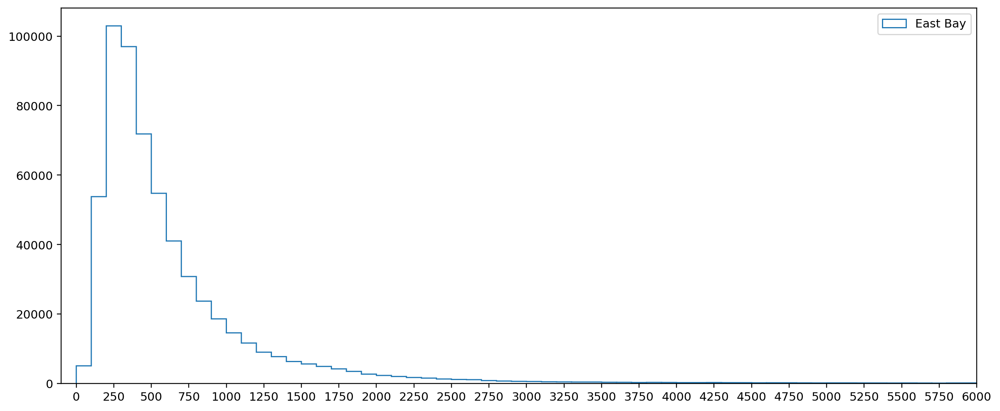

In [88]:
fig, axes = plt.subplots(figsize=(12, 5), dpi=110)
df_new = df.query(f"label_name == 'East Bay'")

bin_size = 100
bins = np.arange(0, df_new.duration_sec.max()+bin_size, bin_size)

plt.hist(df_new.duration_sec, bins=bins, label=x, histtype='step')

plt.xticks(ticks=[x for x in range(0, 7000, 250)])
plt.legend()
plt.xlim(-100, 6000)
plt.tight_layout()

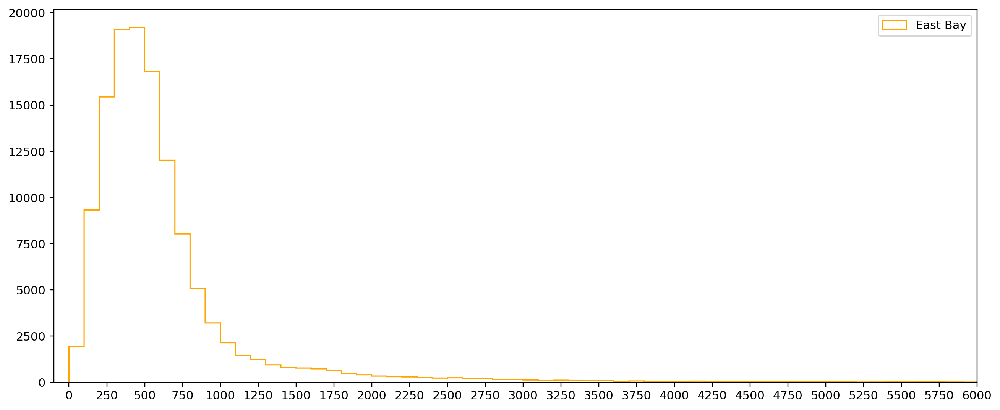

In [89]:
fig, axes = plt.subplots(figsize=(12, 5), dpi=110)
df_new = df.query(f"label_name == 'San José'")

bin_size = 100
bins = np.arange(0, df_new.duration_sec.max()+bin_size, bin_size)

plt.hist(df_new.duration_sec, bins=bins, label=x,
         histtype='step', color="orange")

plt.xticks(ticks=[x for x in range(0, 7000, 250)])
plt.legend()
plt.xlim(-100, 6000)
plt.tight_layout()

Let's look at the user structure

Text(0.5, 0, '')

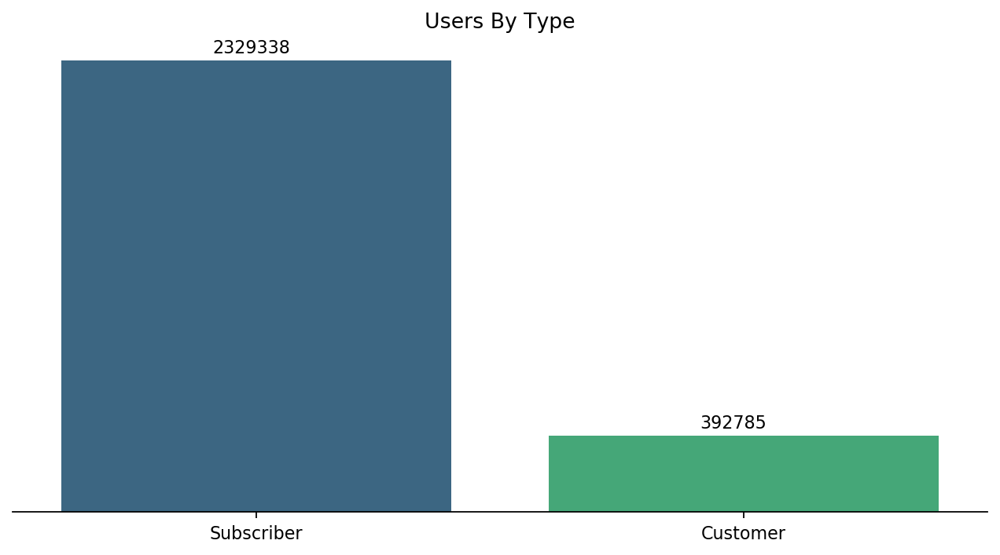

In [90]:
value_ct = df.user_type.value_counts().iloc[:31]

fig, ax = plt.subplots(figsize=(10, 5), dpi=80)
sns.countplot(x="user_type", data=df, order=value_ct.index, palette="viridis")

cur_axes = plt.gca()
cur_axes.axes.get_yaxis().set_visible(False)
sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.31, p.get_height()+40000))

plt.title("Users By Type")
plt.xlabel("")

Text(0.5, 0, '')

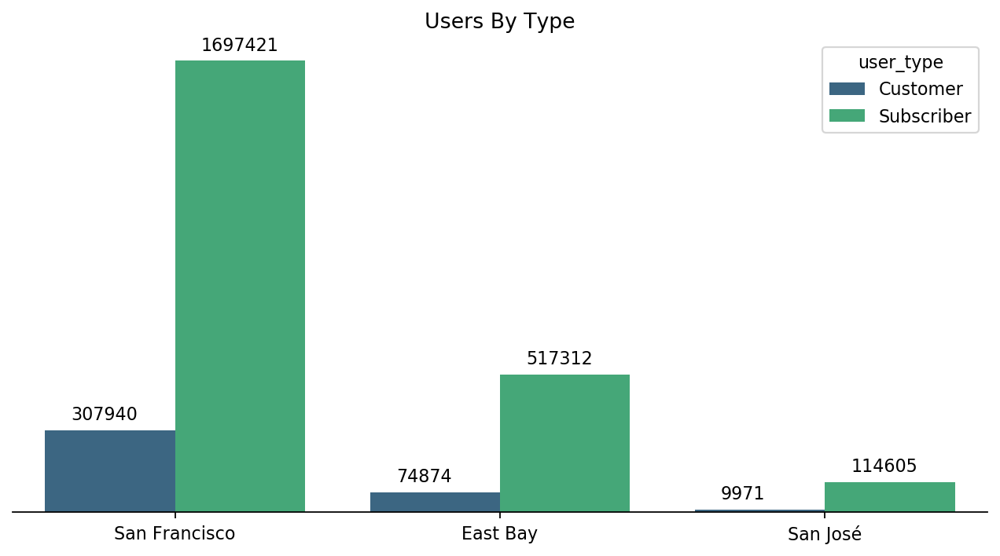

In [91]:
value_ct = df.label_name.value_counts().iloc[:31]

fig, ax = plt.subplots(figsize=(10, 5), dpi=80)
sns.countplot(x="label_name", data=df, order=value_ct.index, hue="user_type")

cur_axes = plt.gca()
cur_axes.axes.get_yaxis().set_visible(False)
sns.despine(fig, left=True)

for p in ax.patches:
    ax.annotate('{:.0f}'.format(p.get_height()),
                (p.get_x()+0.08, p.get_height()+40000))

plt.title("Users By Type")
plt.xlabel("")

There seems to be a lot more Subscribers than Customers using the service

For the next plots we will focus on the time components of the data. At first we will explore on which days people like to go on trips. 0 refers to Monday while 6 refers to Sunday.

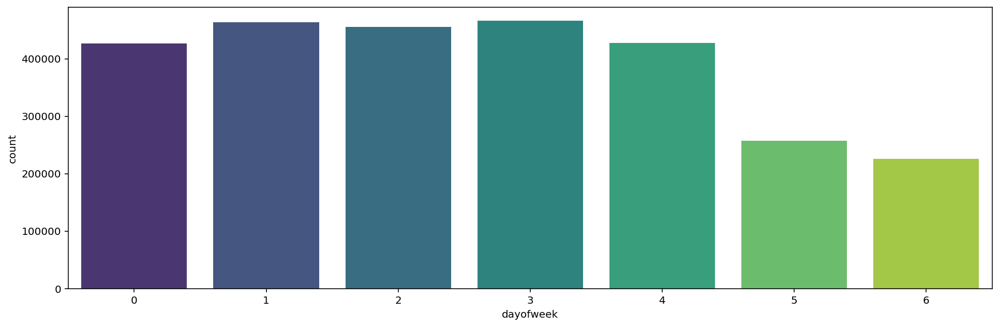

In [92]:
fig, ax = plt.subplots(figsize=(16, 5))
sns.countplot(x="dayofweek", data=df)

Based on this graph it looks like users use the bikes more during the week than during the weekend. Tuesdays and Thursdays seem to be the most popular days for using the bike sharing system, however Wednesdays, Mondays and Fridays are very close to the Tues/Thurs numbers. The usage drops significantly on Saturdays and Sundays suggesting that the sharing service is used primarily for commuting purposes during working days.

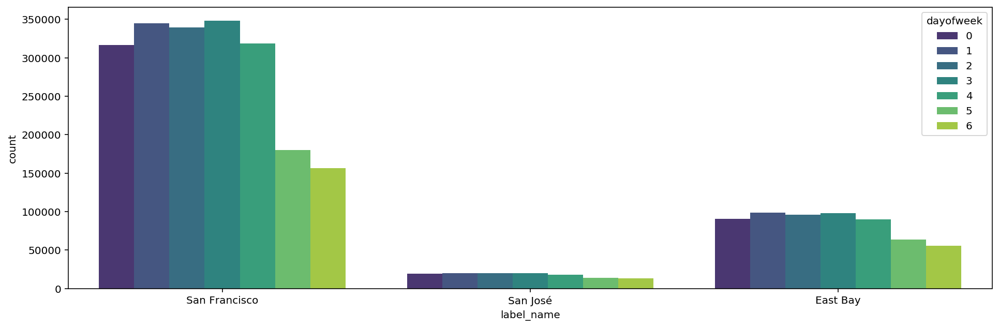

In [93]:
fig, ax = plt.subplots(figsize=(16, 5))
sns.countplot(x="label_name", data=df, hue="dayofweek")

In [94]:
for x in mapping.values():
    print(f"{x}\n", df.query(f"label_name == '{x}'").dayofweek.value_counts(
    ).sort_index() / df.query(f"label_name == '{x}'").dayofweek.count(), "\n")

San Francisco
 0    0.158001
1    0.172067
2    0.169368
3    0.173694
4    0.159008
5    0.089682
6    0.078180
Name: dayofweek, dtype: float64 

San José
 0    0.153392
1    0.162070
2    0.161444
3    0.159726
4    0.144546
5    0.112799
6    0.106024
Name: dayofweek, dtype: float64 

East Bay
 0    0.152667
1    0.166390
2    0.161991
3    0.165662
4    0.152337
5    0.107250
6    0.093702
Name: dayofweek, dtype: float64 



This applies for all three areas. Tuesday, Wednesday and Thursday are the most active days, followed by Monday and Friday and then Saturday and Sunday. Now let's look on the trips per month/year.

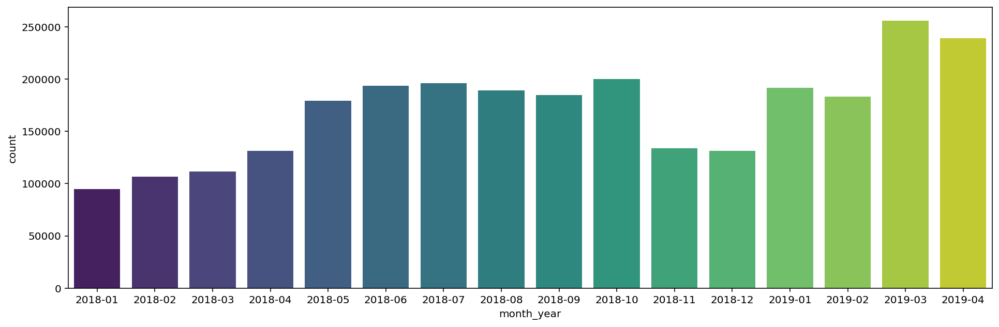

In [95]:
fig, ax = plt.subplots(figsize=(16, 5))
sns.countplot(x="month_year", data=df)

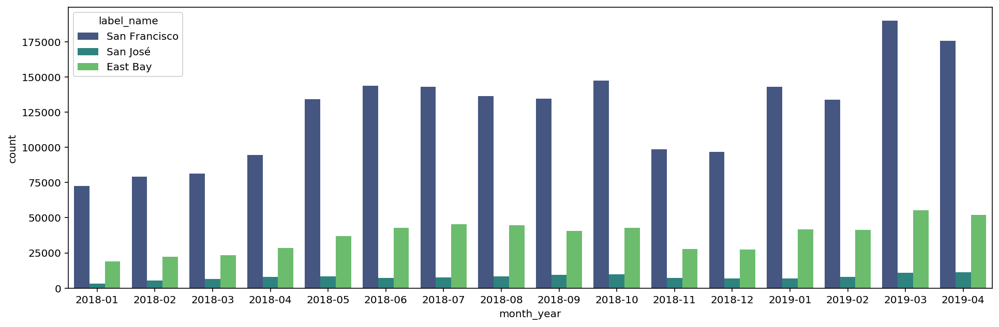

In [96]:
fig, ax = plt.subplots(figsize=(16, 5))
sns.countplot(x="month_year", data=df, hue="label_name")

For all three areas we can see that Bikesharing drops during 2018-11 - 2018-12 followed by highest usage in 2019-03 - 2019-04.

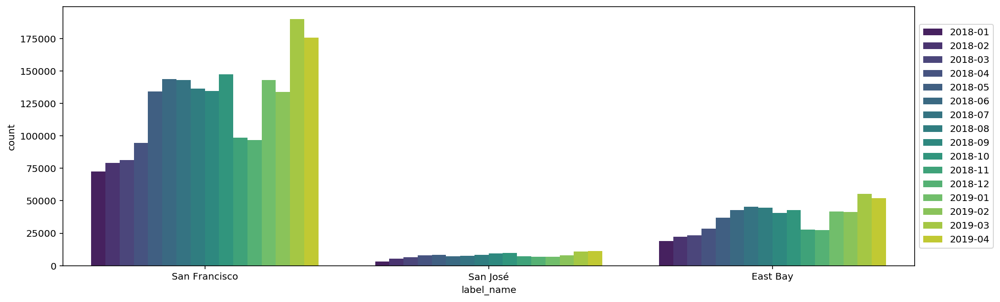

In [97]:
fig, ax = plt.subplots(figsize=(20, 5))
sns.countplot(x="label_name", data=df, hue="month_year")
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
# Put a legend to the right of the current axis
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

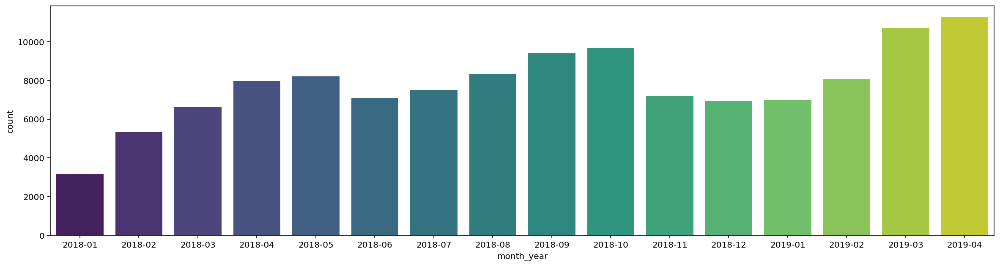

In [98]:
fig, ax = plt.subplots(figsize=(20, 5))
sns.countplot(x="month_year", data=df.query(
    "label_name == 'San José'"))

The drop for the "San José" area held on for on more month till January after which we see a rise in usage.

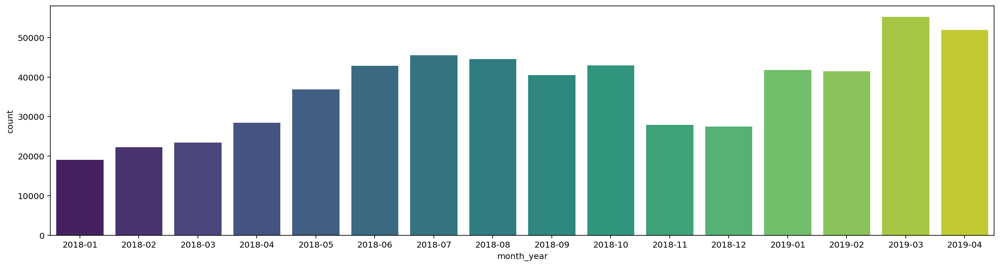

In [99]:
fig, ax = plt.subplots(figsize=(20, 5))
sns.countplot(x="month_year", data=df.query(
    "label_name == 'East Bay'"))

In "East Bay", the service usage increase after December 2018 and is seen highest during 3rd and 4th month.

In [100]:
# assigning colors to day of the week
custom_palette = {}
for q in set(df.day_month_year):
    if q.dayofweek == 0:
        custom_palette[q] = sns.color_palette("viridis")[0]
    elif q.dayofweek == 1:
        custom_palette[q] = sns.color_palette("viridis")[1]
    elif q.dayofweek == 2:
        custom_palette[q] = sns.color_palette("viridis")[2]
    elif q.dayofweek == 3:
        custom_palette[q] = sns.color_palette("viridis")[3]
    elif q.dayofweek == 4:
        custom_palette[q] = sns.color_palette("viridis")[4]
    elif q.dayofweek == 5:
        custom_palette[q] = sns.color_palette("viridis")[5]
    elif q.dayofweek == 6:
        custom_palette[q] = (224/255, 228/255, 65/255)
    else:
        custom_palette[q] = 'g'

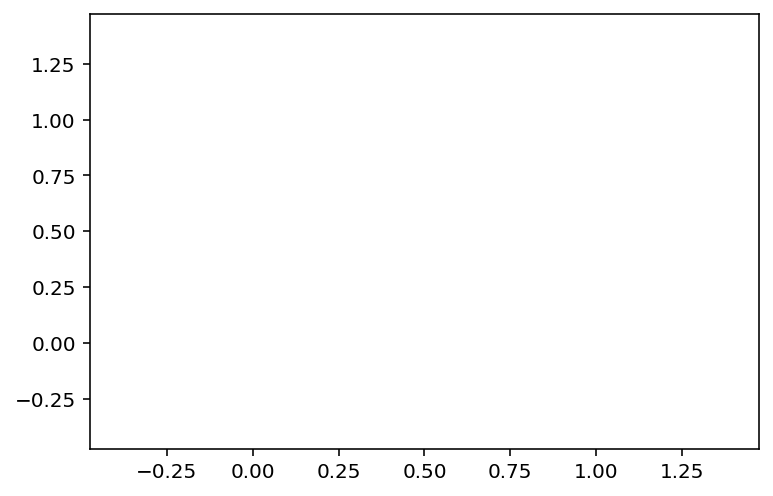

In [101]:
# creating legend object
legend_obj = []

colors = [sns.color_palette("viridis")[0],
          sns.color_palette("viridis")[1],
          sns.color_palette("viridis")[2],
          sns.color_palette("viridis")[3],
          sns.color_palette("viridis")[4],
          sns.color_palette("viridis")[5],
          (224/255, 228/255, 65/255)]

days = ["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"]

for i, s in enumerate(days):
    legend_obj.append(plt.scatter([], [], color=colors[i]))

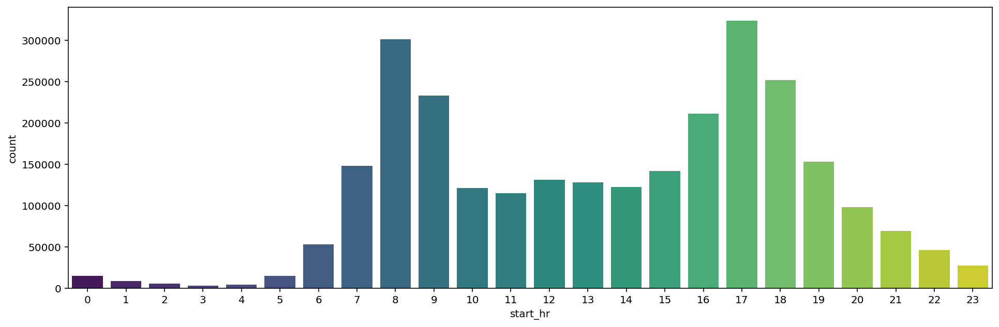

In [102]:
fig, ax = plt.subplots(figsize=(16, 5))

sns.countplot(x="start_hr", data=df, ax=ax)

The most frequent starting hours are at 800 and at 1700. Maybe people use it before and after work, which would make sense, because we have a lot of subscribers in working age in our dataset. You only subscribe to something, if you want to use it regularly. The integration into the working/study life would make sense here.

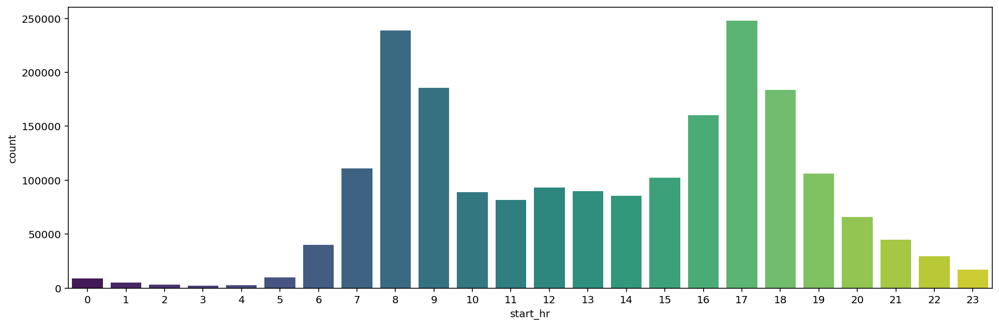

In [103]:
fig, ax = plt.subplots(figsize=(16, 5))

sns.countplot(x="start_hr", data=df.query(
    "label == 0"), ax=ax)

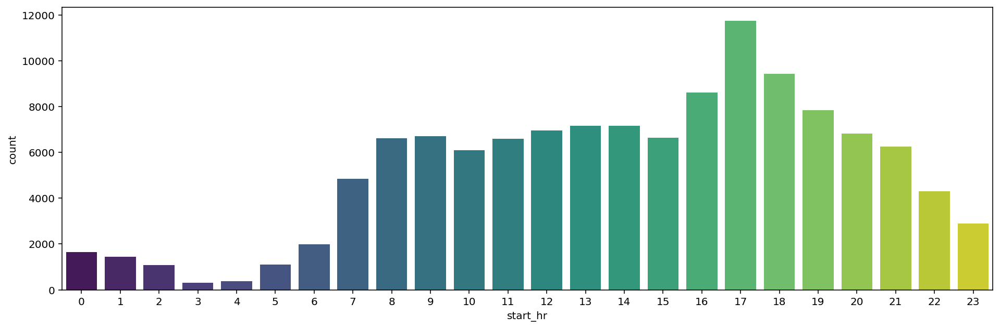

In [104]:
fig, ax = plt.subplots(figsize=(16, 5))

sns.countplot(x="start_hr", data=df.query(
    "label == 1"), ax=ax)

For San José the trend is going more torwards the hour 1700.

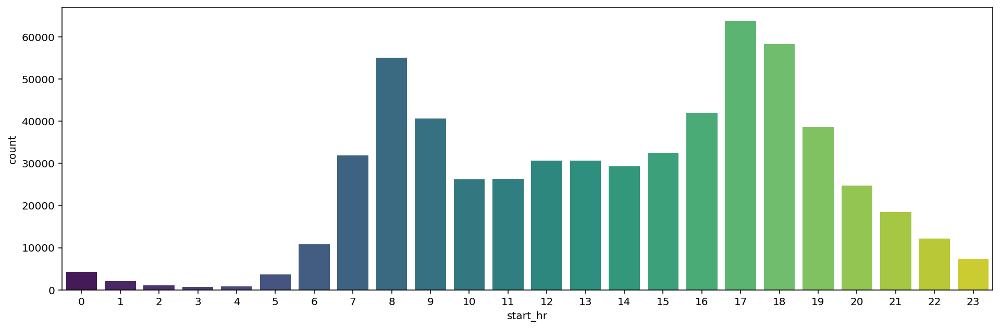

In [105]:
fig, ax = plt.subplots(figsize=(16, 5))

sns.countplot(x="start_hr", data=df.query(
    "label == 2"), ax=ax)

As we saw, the most frequent hours are 800 and 1700. I want to see how this trend is changing over time, so for the next plot we will connect these two counts with a line to see the trend based on the slope.

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

Thankfully, due to thorough cleaning efforts there were no big surprises during the exploratory and visualization phase.

### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

Nothing seems out of the normal expectations for a bike sharing system in a major city. So far, the data reveals that service has been heavily utilized during normal working hours and more and more people are subscribing to the service as per 2018-2019 graphs which is good. A little fiddling was necessary to plot the day wise usage of the service but it was mostly for aesthetic purposes.

## Bivariate Exploration

Now we are going to dig deeper into the data searching for relationships and trends between variables

In [106]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,start_station_id_new,end_station_id_new,new_id,label,label_name,month_year,day_month_year,dayofweek,start_hr,end_hr
0,13709,2018-01-01 00:01:53.847,2018-01-01 03:50:23.433,86,Market St at Dolores St,37.769305,-122.426826,119,18th St at Noe St,37.761047,...,86_0,119_0,86_0,0,San Francisco,2018-01,2018-01-01,0,0,3
1,9996,2018-01-01 04:37:08.115,2018-01-01 07:23:44.143,86,Market St at Dolores St,37.769305,-122.426826,223,16th St Mission BART Station 2,37.764765,...,86_0,223_0,86_0,0,San Francisco,2018-01,2018-01-01,0,4,7
2,197,2018-01-01 09:29:57.079,2018-01-01 09:33:14.662,86,Market St at Dolores St,37.769305,-122.426826,85,Church St at Duboce Ave,37.770083,...,86_0,85_0,86_0,0,San Francisco,2018-01,2018-01-01,0,9,9
3,183,2018-01-01 11:25:27.634,2018-01-01 11:28:31.059,86,Market St at Dolores St,37.769305,-122.426826,75,Market St at Franklin St,37.773793,...,86_0,75_0,86_0,0,San Francisco,2018-01,2018-01-01,0,11,11
4,893,2018-01-01 12:07:39.271,2018-01-01 12:22:32.393,86,Market St at Dolores St,37.769305,-122.426826,42,San Francisco City Hall (Polk St at Grove St),37.778650,...,86_0,42_0,86_0,0,San Francisco,2018-01,2018-01-01,0,12,12


In [107]:
# join the trips together
df["combi"] = df["start_station_id_new"] + " - " + df["end_station_id_new"]
df.combi.value_counts().head(10)

15_0 - 6_0       9464
6_0 - 16_0       6156
81_0 - 15_0      6097
196_0 - 182_0    5405
182_0 - 196_0    5003
6_0 - 15_0       4731
16_0 - 6_0       4193
15_0 - 81_0      4177
90_0 - 67_0      4027
58_0 - 67_0      3937
Name: combi, dtype: int64

One interesting insight are the most frequent trips. Based on the data in the upper cell we can see, that the station 6_0 appears often. A heatmap should make this visible.

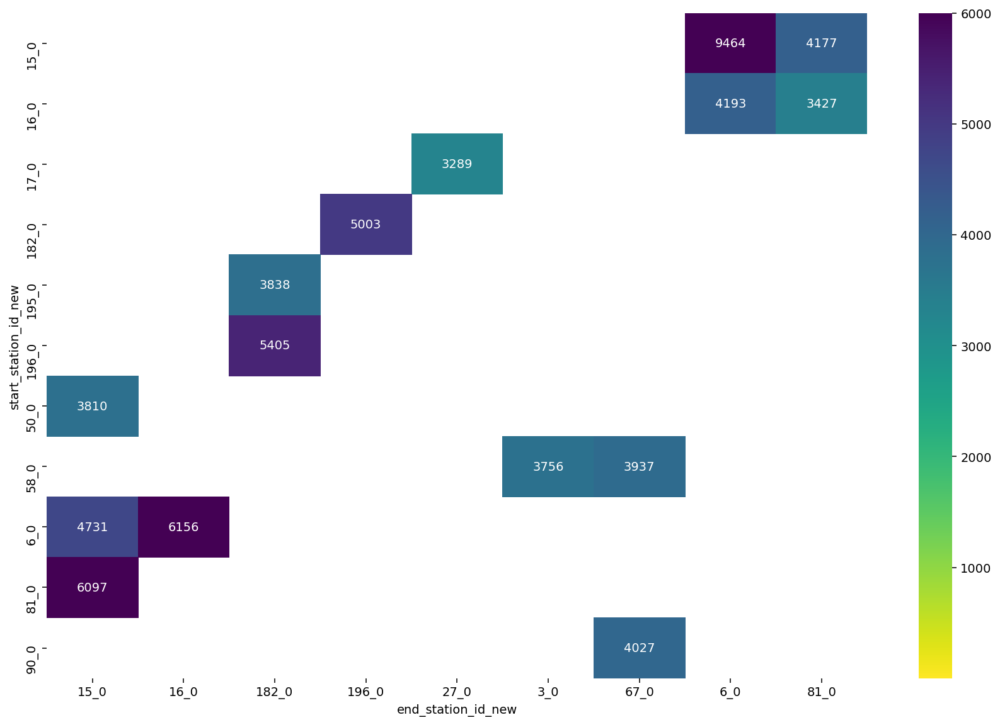

In [108]:
combi_list = df.combi.value_counts().head(15).keys()

df_criteria = df[df["combi"].isin(combi_list)]

df_pivot = df_criteria.pivot_table(
    index="start_station_id_new", columns="end_station_id_new", values="start_time", aggfunc="count", fill_value=0)

fig, axes = plt.subplots(figsize=(15, 10), dpi=70)
sns.heatmap(df_pivot, annot=True, cmap="viridis_r",
            fmt='g', vmin=1, vmax=6000, mask=df_pivot == 0)

Here we can see the top 15 routes.

In [109]:
for i, x in enumerate(combi_list):
    start, end = x.split(" - ")
    start_name = df.query(
        f"start_station_id_new == '{start}'").start_station_name.drop_duplicates().to_numpy()
    end_name = df.query(
        f"end_station_id_new == '{end}'").end_station_name.drop_duplicates().to_numpy()
    print(start, " ", start_name[0], " --> ", end, " ", end_name[0])

15_0   San Francisco Ferry Building (Harry Bridges Plaza)  -->  6_0   The Embarcadero at Sansome St
6_0   The Embarcadero at Sansome St  -->  16_0   Steuart St at Market St
81_0   Berry St at 4th St  -->  15_0   San Francisco Ferry Building (Harry Bridges Plaza)
196_0   Grand Ave at Perkins St  -->  182_0   19th Street BART Station
182_0   19th Street BART Station  -->  196_0   Grand Ave at Perkins St
6_0   The Embarcadero at Sansome St  -->  15_0   San Francisco Ferry Building (Harry Bridges Plaza)
16_0   Steuart St at Market St  -->  6_0   The Embarcadero at Sansome St
15_0   San Francisco Ferry Building (Harry Bridges Plaza)  -->  81_0   Berry St at 4th St
90_0   Townsend St at 7th St  -->  67_0   San Francisco Caltrain Station 2  (Townsend St at 4th St)
58_0   Market St at 10th St  -->  67_0   San Francisco Caltrain Station 2  (Townsend St at 4th St)
195_0   Bay Pl at Vernon St  -->  182_0   19th Street BART Station
50_0   2nd St at Townsend St  -->  15_0   San Francisco Ferry Buil

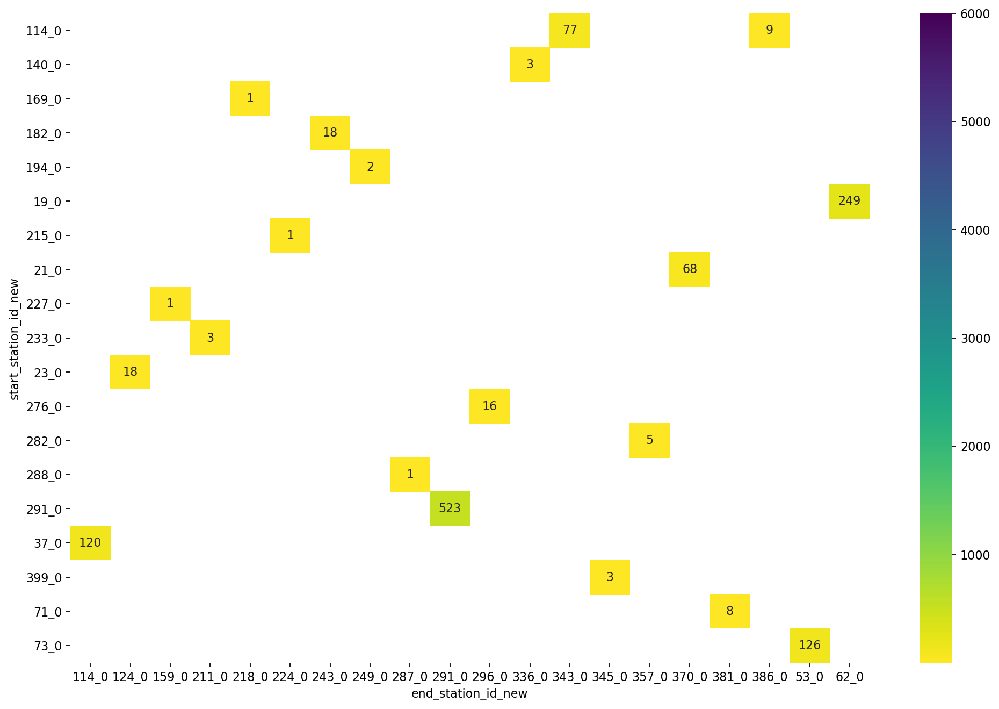

In [110]:
combi_list = df.combi.value_counts().sample(20).keys()

df_criteria = df[df["combi"].isin(combi_list)]

df_pivot = df_criteria.pivot_table(
    index="start_station_id_new", columns="end_station_id_new", values="start_time", aggfunc="count", fill_value=0)

fig, axes = plt.subplots(figsize=(15, 10), dpi=80)
sns.heatmap(df_pivot, annot=True, cmap="viridis_r",
            fmt='g', vmin=1, vmax=6000, mask=df_pivot == 0)

Another interesting combination would be the day of the week combined with the average duration. For this we will create a groupby - object (mean) over each month-year combination. A Box Plot should be appropriate to visualize this relationship.

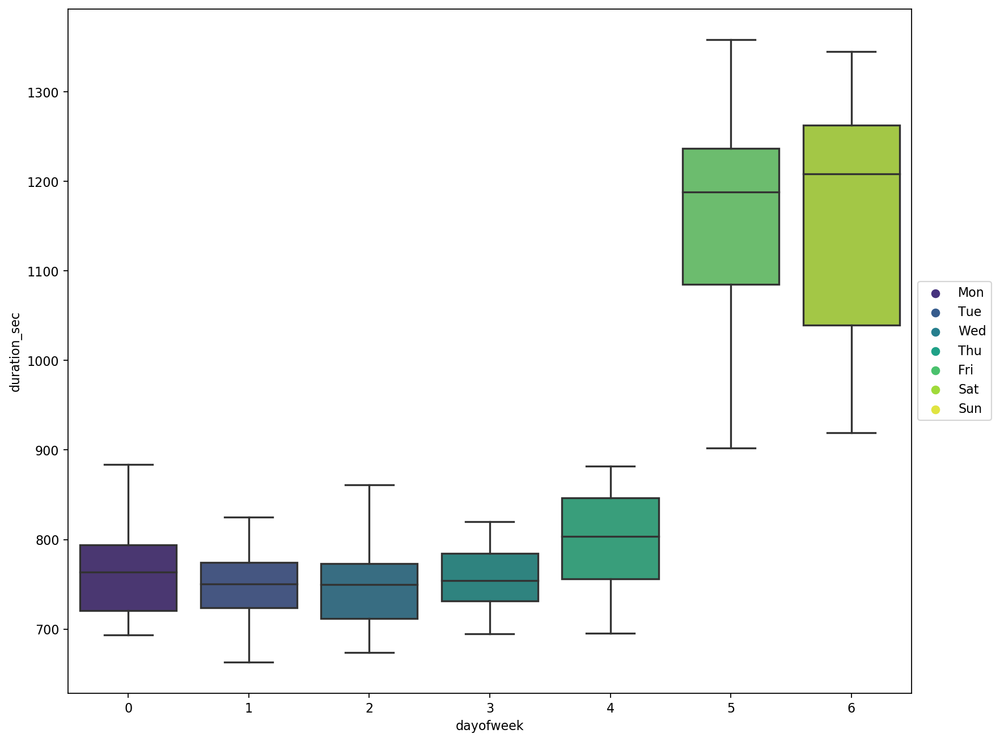

In [111]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="dayofweek", y="duration_sec", data=df.groupby(
    ["dayofweek", "month_year"], as_index=False).mean())

box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
# Put a legend to the right of the current axis
ax.legend(legend_obj, days, loc='center left', bbox_to_anchor=(1, 0.5))

We can clearly see, that under the week the users are going on shorter trips ~780 Seconds while the average duration on the weekend rises to ~1200 seconds.

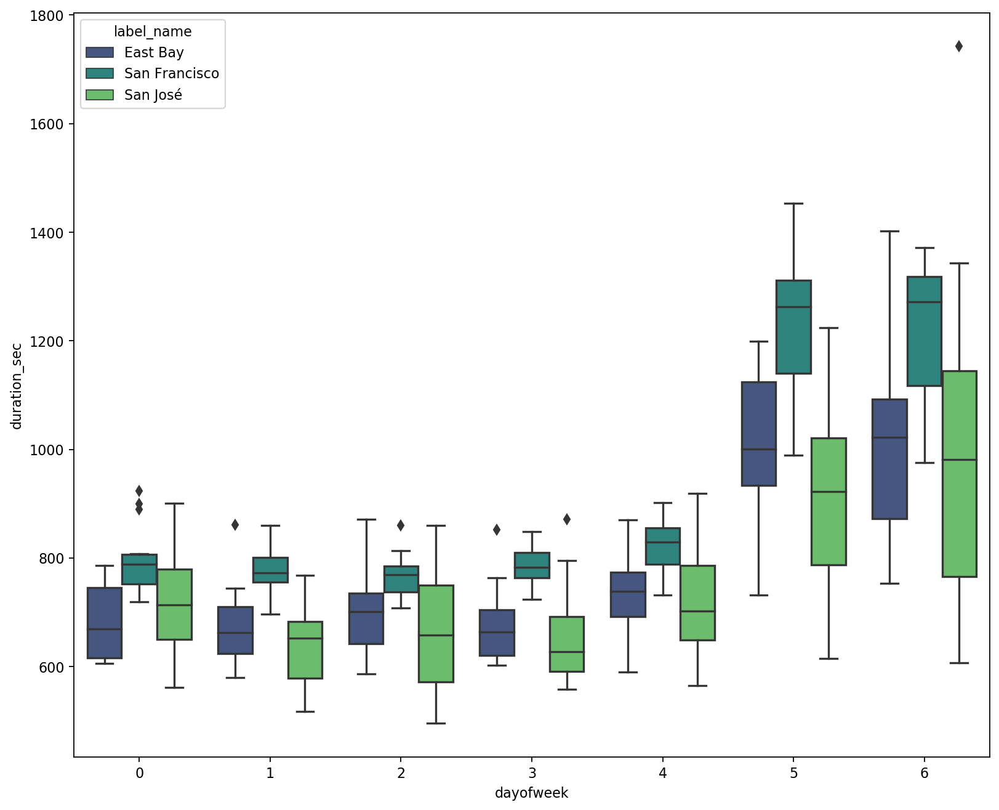

In [112]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="dayofweek", y="duration_sec", data=df.groupby(
    ["dayofweek", "month_year", "label_name"], as_index=False).mean(), hue="label_name")

box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

This trend applies for all areas, while we can also see that the users of San Francisco have, on average, the longest duration of trips, followed by East Bay and then San José. Now we should explore if the duration is also different based on the starting hour.

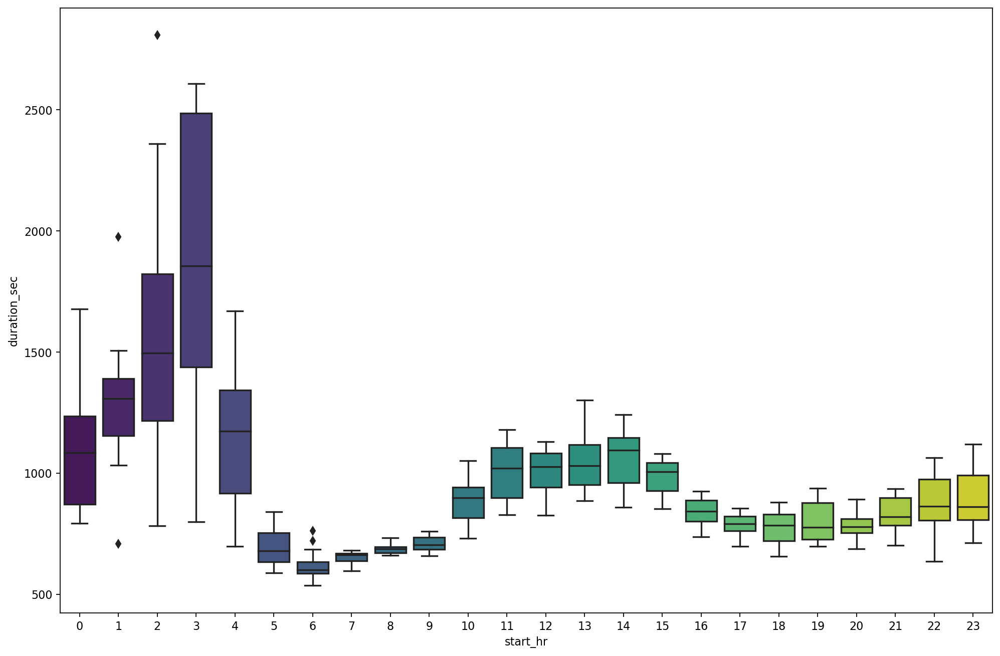

In [113]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="start_hr", y="duration_sec", data=df.groupby(
    ["start_hr", "month_year"], as_index=False).mean())

Starting from the hours 0, 1, 2, 3 we maybe have to deal with outliers. On the other hand we saw earlier, that there are not much trips starting at that time, so longer trips have a stronger impact then at 8 o' clock for example. From 5 - 9 trips are relatively short with ~600 seconds, then the average rises to ~950 from 10 - 15. From 16 - 20 it drops again to ~700 seconds to finally increase slightly around 22 and 23.

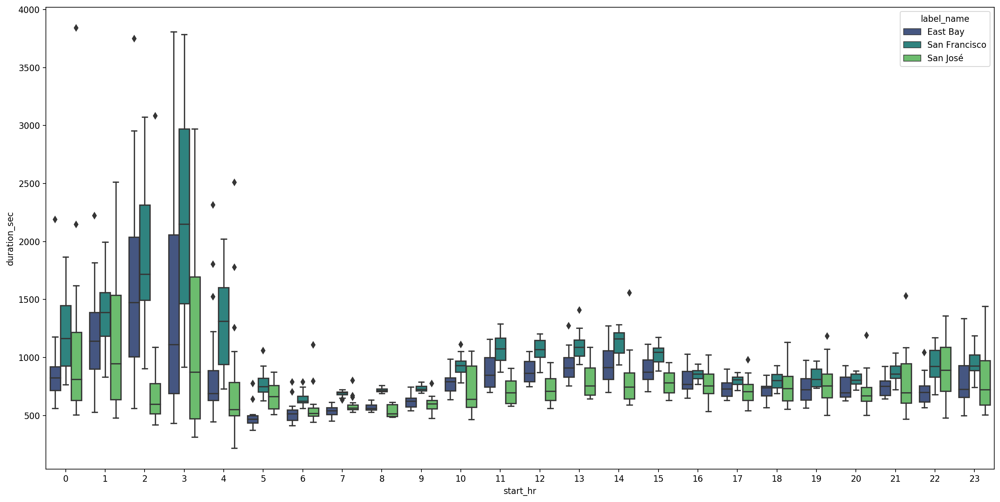

In [114]:
fig, ax = plt.subplots(figsize=(20, 10), dpi=80)
sns.boxplot(x="start_hr", y="duration_sec", data=df.groupby(
    ["start_hr", "month_year", "label_name"], as_index=False).mean(), hue="label_name")

Here the hours 0 - 4 are getting more unclear. This graph confirms again, that San Francisco has, on average, the longest duration of trips, while users of East Bay and San José tend to have shorter trips.

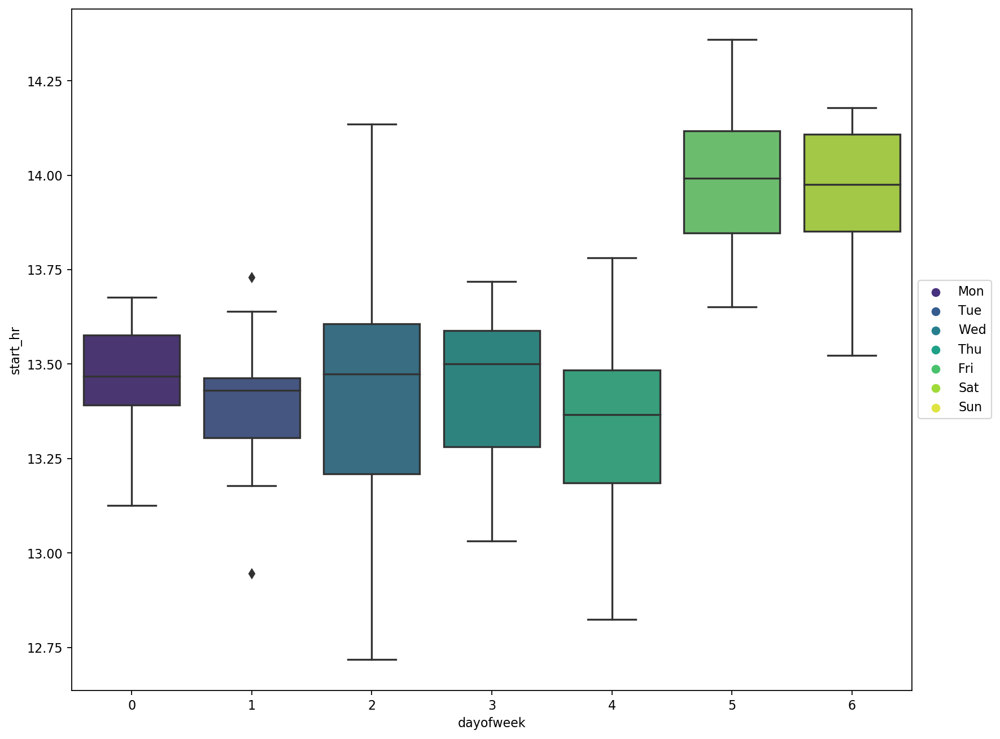

In [115]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="dayofweek", y="start_hr", data=df.groupby(
    ["dayofweek", "month_year"], as_index=False).mean())

box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
# Put a legend to the right of the current axis
ax.legend(legend_obj, days, loc='center left',
          bbox_to_anchor=(1, 0.5))

This graph shows, that people start their trips, on average, later on the weekend than during the week.

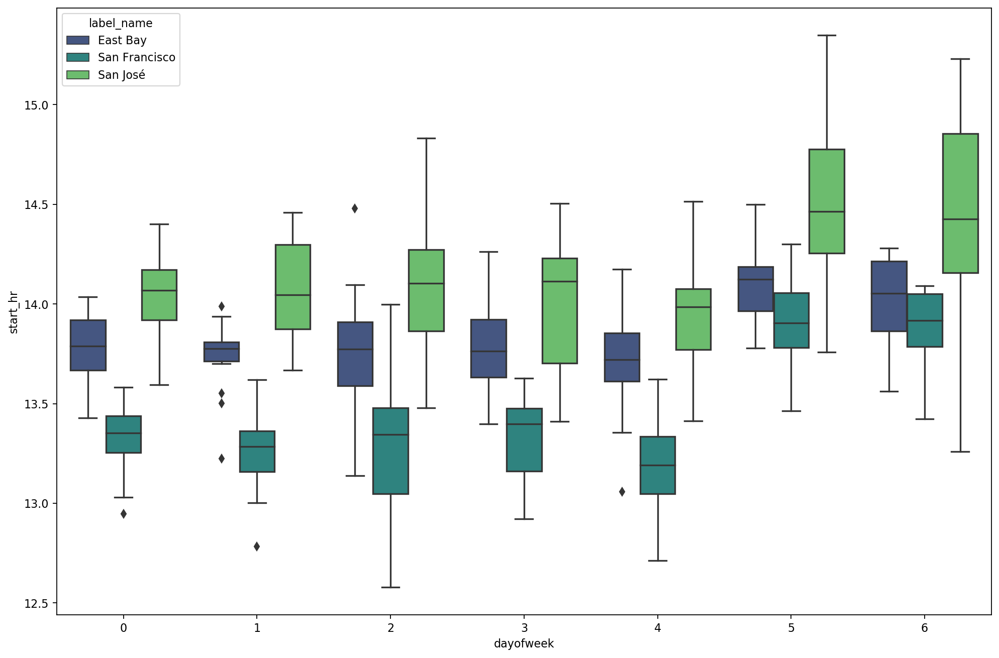

In [116]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="dayofweek", y="start_hr", data=df.groupby(
    ["dayofweek", "month_year", "label_name"], as_index=False).mean(), hue="label_name")

Looking at each area is interesting, because Users from East Bay and San José are not only have shorter trip durations on average, but also they start their trips later than San Francisco on average.

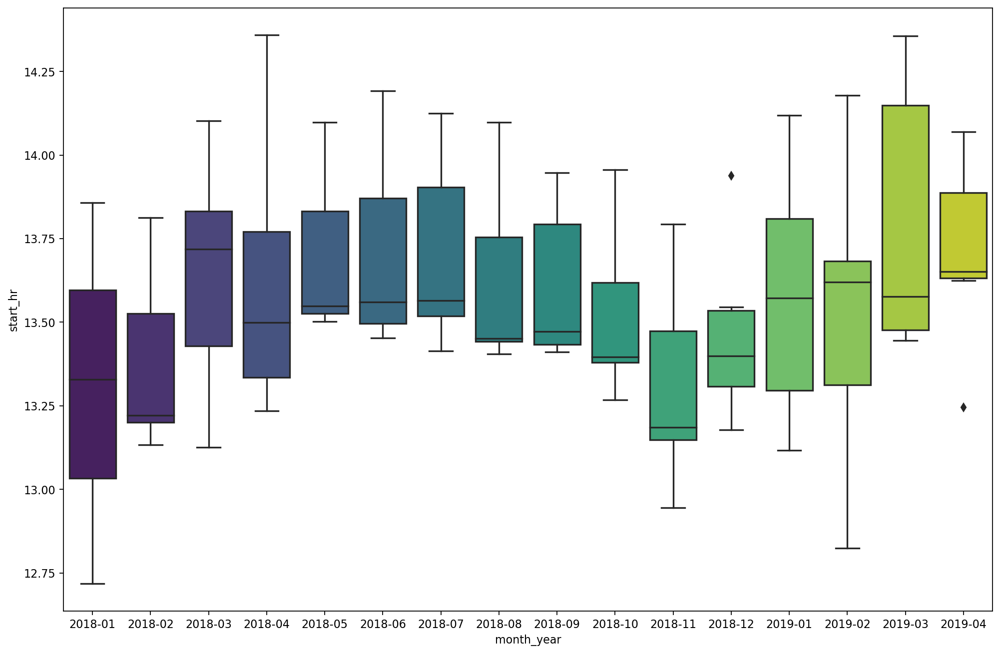

In [117]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="month_year", y="start_hr", data=df.groupby(
    ["month_year", "dayofweek"], as_index=False).mean())

This shows, that on average the users start later in the middle of the year than at the beginning or the end of the year.

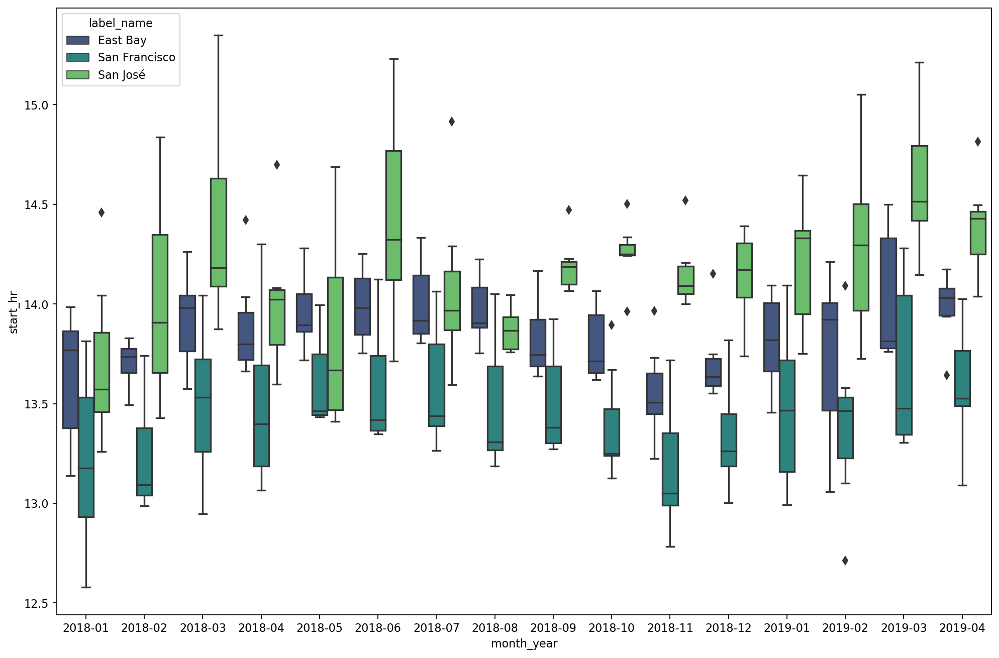

In [118]:
fig, ax = plt.subplots(figsize=(15, 10), dpi=80)
sns.boxplot(x="month_year", y="start_hr", data=df.groupby(
    ["month_year", "dayofweek", "label_name"], as_index=False).mean(), hue="label_name")

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

We see that the more trips are taken during the week and start and end at a very predictable time which suggest that people use the service for commute to work. As the year goes by, the work timings change according to the season and the trip start time also changes accordingly which clearly shows. Amount of trips taken have increased as 2019 started off, which can mean that people tend to start riding bikes for better health (new year resolution, maybe...?)

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

The trips start hours at around 0-400 hrs and their duration at those times points out potential outliers. This was particularly interesting as normal working hours are around 800-900hrs in the morning and 1500-1600hrs in the evening but some of the trips taken were well before the morning and were a lot longer. This may be because people tend to workout in the morning and riding a bike is a pretty good workout but we don't have any data on this so we cannot verify this.

## Multivariate Exploration

For the last explorative visualization we will take a look on a visualization on the trips with kepler.gl

In [119]:
df_station_names.head()

,id,station_name,station_latitude,station_longitude,new_id,label,label_name
0,10,Washington St at Kearny St,37.795393,-122.404770,10_0,0,San Francisco
1,100,Bryant St at 15th St,37.767100,-122.410662,100_0,0,San Francisco
2,101,15th St at Potrero Ave,37.767079,-122.407359,101_1,0,San Francisco
3,101,San Bruno Ave at 16th St,37.766008,-122.405677,101_0,0,San Francisco
5,102,Irwin St at 8th St,37.766883,-122.399579,102_0,0,San Francisco


In [120]:
df_trips = df[["start_station_latitude", "start_station_longitude",  "end_station_latitude",
               "end_station_longitude", "start_station_id_new", "end_station_id_new"]].copy()

In [121]:
df_trips["cnt"] = 1

In [122]:
df_trips_grp = df_trips.groupby(
    [x for x in df_trips.columns[:-1]], as_index=False).sum().sort_values("cnt", ascending=False)

In [123]:
df_trips_grp.head()

,start_station_latitude,start_station_longitude,end_station_latitude,end_station_longitude,start_station_id_new,end_station_id_new,cnt
29169,37.795392,-122.394203,37.804770,-122.403234,15_0,6_0,9464
32003,37.804770,-122.403234,37.794130,-122.394430,6_0,16_0,6156
18263,37.775880,-122.393170,37.795392,-122.394203,81_0,15_0,6097
32929,37.808894,-122.256460,37.809013,-122.268247,196_0,182_0,5405
33051,37.809013,-122.268247,37.808894,-122.256460,182_0,196_0,5003


In [124]:
df_trips_grp.to_csv("./data/processed/grps.csv", index=False)

At first we will look at San Francisco trips:
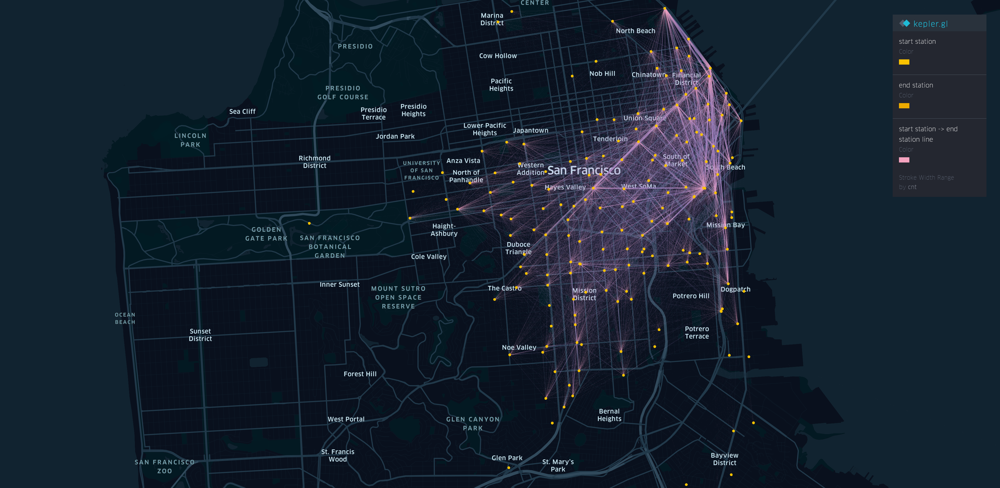

We can see that most of the trips are close to the beach.:
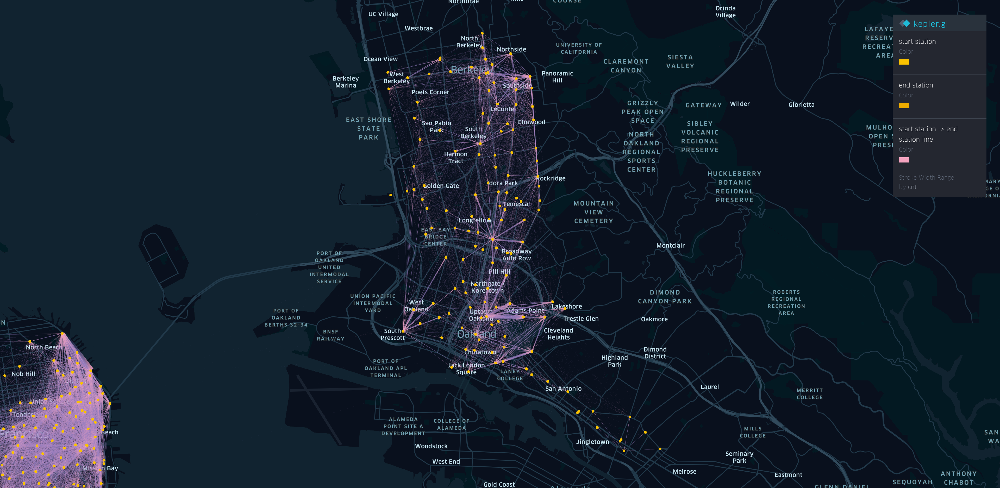

Here the main routes are much more spread than in San Francisco. Also it looks like people use this service to quickly overcome smaller distances.
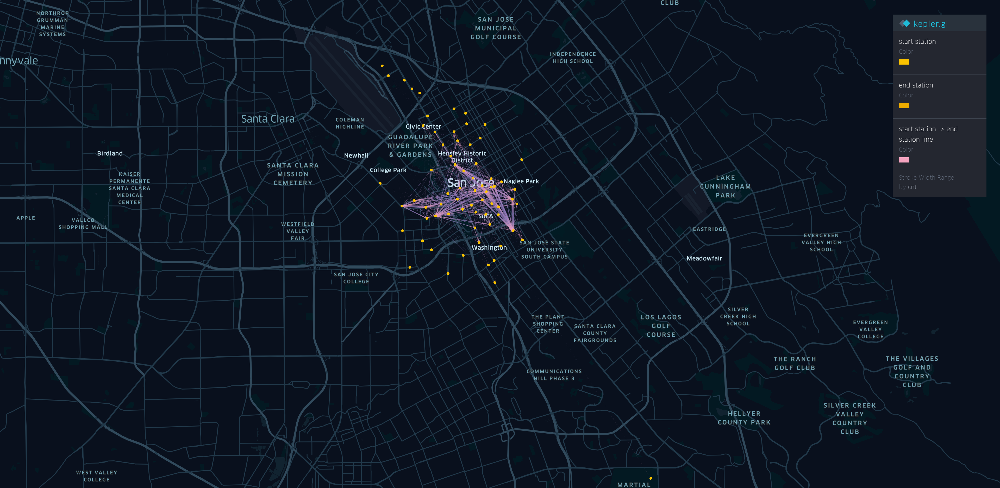

For San José it looks spread over most of the stations.

## Summary and Conclusions

From our exploration we can note that:

- This data covers three areas: San Francisco, East Bay and San José
- The highest count of trips can be found in San Francisco, followed by East Bay and San José
- The average trips is ~700 seconds long, the most trips were around ~500 seconds long
- San Francisco has the longest trips with ~717 seconds, followed by East Bay with ~631 seconds and San José with ~627seconds
- There are a lot more subscribers than customer using this service
- People use the bikes more/in higher counts during the week than during the weekend
- On the other hand the trips on the weekend are longer, ~1100 seconds than during the week which is about ~780 seconds
- Also people start their trips later during the weekends than during the week (~1400hrs instead of ~1320hrs during the week)
- Overall San Francisco has the longest average trips, followed by East Bay and San José
- Users starting in the morning and in the evening have shorter trips than people who start between 11 and 15
- In San Jose the trips start on average the latest, followed by East Bay and San Francisco
- There is an increasing trend of usage
- People start their trips most frequently at 800hrs and 1700hrs
- The most popular trip so far is between stations 15_0 San Francisco Ferry Building (Harry Bridges Plaza) and 6_0 The Embarcadero at Sansome St

## Sources referred

- https://stackoverflow.com/questions/3451111/unzipping-files-in-python/3451150
- https://stackoverflow.com/questions/19412462/getting-distance-between-two-points-based-on-latitude-longitude/43211266#43211266
- https://datatofish.com/k-means-clustering-python/
- https://codeyarns.com/2015/06/29/how-to-hide-axis-of-plot-in-matplotlib/
- https://stackoverflow.com/questions/43855474/changing-sort-in-value-counts
- https://stackoverflow.com/questions/4700614/how-to-put-the-legend-out-of-the-plot
- https://stackoverflow.com/questions/35143672/seaborn-conditional-colors-based-on-value
- Udacity Course Material
- Library documentations